## Case Study on Customer Retention with Detailed Data Analysis

### E-retail factors for customer activation and retention: A case study from Indian e-commerce customers

Customer satisfaction has emerged as one of the most important factors that guarantee the success of online store; it has been posited as a key stimulant of purchase, repurchase intentions and customer loyalty. A comprehensive review of the literature, theories and models have been carried out to propose the models for customer activation and customer retention. Five major factors that contributed to the success of an e-commerce store have been identified as: service quality, system quality, information quality, trust and net benefit. The research furthermore investigated the factors that influence the online customers repeat purchase intention. The combination of both utilitarian value and hedonistic values are needed to affect the repeat purchase intention (loyalty) positively. The data is collected from the Indian online shoppers. Results indicate the e-retail success factors, which are very much critical for customer satisfaction.

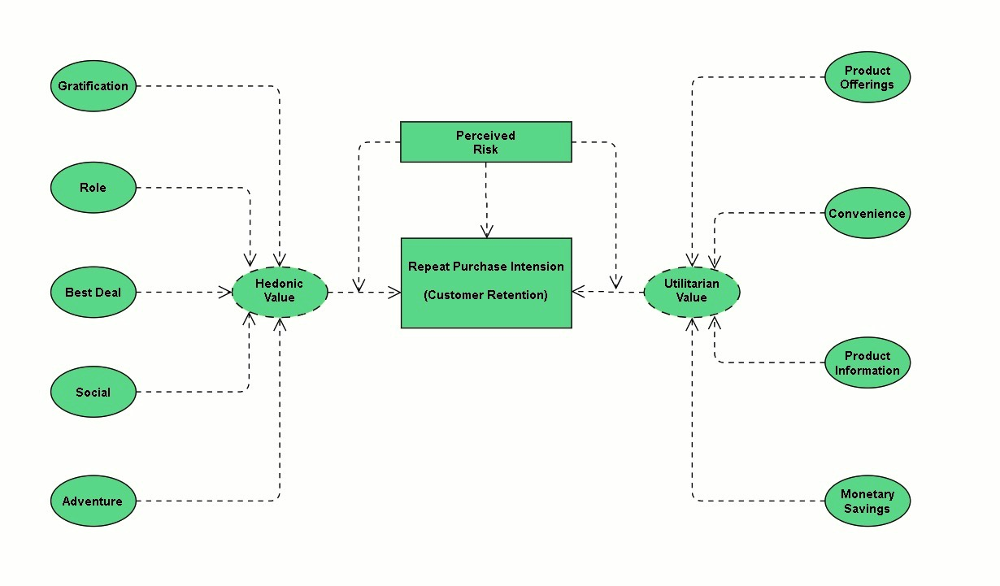

In [164]:
#importing required libraries

import pandas as pd
import numpy as np

import seaborn as sns

import matplotlib.pyplot as plt
%matplotlib inline

import missingno
import pandas_profiling

from sklearn.preprocessing import OrdinalEncoder

import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

# Importing datasets

In [165]:
# importing dataset and assiging it to xls
xls = pd.ExcelFile('customer_retention_dataset.xlsx')

In [166]:
# importing excel sheet_1 assigning it to df1
df1= pd.read_excel(xls, 'datasheet')

In [167]:
# importing excel sheet_2 assigning it to df2
df2= pd.read_excel(xls, 'codedsheet')

The excel file and then separated the spreadsheets in 2 different dataframes.

In [168]:
#checking dataset 1
df1

,1Gender of respondent,2 How old are you?,3 Which city do you shop online from?,4 What is the Pin Code of where you shop online from?,5 Since How Long You are Shopping Online ?,6 How many times you have made an online purchase in the past 1 year?,7 How do you access the internet while shopping on-line?,8 Which device do you use to access the online shopping?,9 What is the screen size of your mobile device?\t\t\t\t\t\t,10 What is the operating system (OS) of your device?\t\t\t\t,11 What browser do you run on your device to access the website?\t\t\t,12 Which channel did you follow to arrive at your favorite online store for the first time?,"13 After first visit, how do you reach the online retail store?\t\t\t\t",14 How much time do you explore the e- retail store before making a purchase decision?,15 What is your preferred payment Option?\t\t\t\t\t,16 How frequently do you abandon (selecting an items and leaving without making payment) your shopping cart?\t\t\t\t\t\t\t,"17 Why did you abandon the “Bag”, “Shopping Cart”?\t\t\t\t\t",18 The content on the website must be easy to read and understand,19 Information on similar product to the one highlighted is important for product comparison,20 Complete information on listed seller and product being offered is important for purchase decision.,21 All relevant information on listed products must be stated clearly,22 Ease of navigation in website,23 Loading and processing speed,24 User friendly Interface of the website,25 Convenient Payment methods,26 Trust that the online retail store will fulfill its part of the transaction at the stipulated time,27 Empathy (readiness to assist with queries) towards the customers,28 Being able to guarantee the privacy of the customer,"29 Responsiveness, availability of several communication channels (email, online rep, twitter, phone etc.)",30 Online shopping gives monetary benefit and discounts,31 Enjoyment is derived from shopping online,32 Shopping online is convenient and flexible,33 Return and replacement policy of the e-tailer is important for purchase decision,34 Gaining access to loyalty programs is a benefit of shopping online,35 Displaying quality Information on the website improves satisfaction of customers,36 User derive satisfaction while shopping on a good quality website or application,37 Net Benefit derived from shopping online can lead to users satisfaction,38 User satisfaction cannot exist without trust,39 Offering a wide variety of listed product in several category,40 Provision of complete and relevant product information,41 Monetary savings,42 The Convenience of patronizing the online retailer,43 Shopping on the website gives you the sense of adventure,44 Shopping on your preferred e-tailer enhances your social status,45 You feel gratification shopping on your favorite e-tailer,46 Shopping on the website helps you fulfill certain roles,47 Getting value for money spent,"From the following, tick any (or all) of the online retailers you have shopped from;",Easy to use website or application,Visual appealing web-page layout,Wild variety of product on offer,"Complete, relevant description information of products",Fast loading website speed of website and application,Reliability of the website or application,Quickness to complete purchase,Availability of several payment options,Speedy order delivery,Privacy of customers’ information,Security of customer financial information,Perceived Trustworthiness,Presence of online assistance through multi-channel,"Longer time to get logged in (promotion, sales period)","Longer time in displaying graphics and photos (promotion, sales period)","Late declaration of price (promotion, sales period)","Longer page loading time (promotion, sales period)","Limited mode of payment on most products (promotion, sales period)",Longer delivery period,Change in website/Application design,Frequent disruption when moving from one page to another,Website is as efficient as before,Which of the Indian online retailer 

There are 269 rows and 71 columns in the above 'df1' dataset-1 (datasheet)

In [169]:
#checking dataset 2
df2

,1Gender of respondent,2 How old are you?,3 Which city do you shop online from?,4 What is the Pin Code of where you shop online from?,5 Since How Long You are Shopping Online ?,6 How many times you have made an online purchase in the past 1 year?,7 How do you access the internet while shopping on-line?,8 Which device do you use to access the online shopping?,9 What is the screen size of your mobile device?\t\t\t\t\t\t,10 What is the operating system (OS) of your device?\t\t\t\t,11 What browser do you run on your device to access the website?\t\t\t,12 Which channel did you follow to arrive at your favorite online store for the first time?,"13 After first visit, how do you reach the online retail store?\t\t\t\t",14 How much time do you explore the e- retail store before making a purchase decision?,15 What is your preferred payment Option?\t\t\t\t\t,16 How 4 do you abandon (selecting an items and leaving without making payment) your shopping cart?\t\t\t\t\t\t\t,"17 Why did you abandon the “Bag”, “Shopping Cart”?\t\t\t\t\t",18 The content on the website must be easy to read and understand,19 Information on similar product to the one highlighted is important for product comparison,20 Complete information on listed seller and product being offered is important for purchase decision.,21 All relevant information on listed products must be stated clearly,22 Ease of navigation in website,23 Loading and processing speed,24 User friendly Interface of the website,25 Convenient Payment methods,26 Trust that the online retail store will fulfill its part of the transaction at the stipulated time,27 Empathy (readiness to assist with queries) towards the customers,28 Being able to guarantee the privacy of the customer,"29 Responsiveness, availability of several communication channels (email, online rep, twitter, phone etc.)",30 Online shopping gives monetary benefit and discounts,31 Enjoyment is derived from shopping online,32 Shopping online is convenient and flexible,33 Return and replacement policy of the e-tailer is important for purchase decision,34 Gaining access to loyalty programs is a benefit of shopping online,35 Displaying quality Information on the website improves satisfaction of customers,36 User derive satisfaction while shopping on a good quality website or application,37 Net Benefit derived from shopping online can lead to users satisfaction,38 User satisfaction cannot exist without trust,39 Offering a wide variety of listed product in several category,40 Provision of complete and relevant product information,41 Monetary savings,42 The Convenience of patronizing the online retailer,43 Shopping on the website gives you the sense of adventure,44 Shopping on your preferred e-tailer enhances your social status,45 You feel gratification shopping on your favorite e-tailer,46 Shopping on the website helps you fulfill certain roles,47 Getting value for money spent,"From the following, tick any (or all) of the online retailers you have shopped from;",Easy to use website or application,Visual appealing web-page layout,Wild variety of product on offer,"Complete, relevant description information of products",Fast loading website speed of website and application,Reliability of the website or application,Quickness to complete purchase,Availability of several payment options,Speedy order delivery,Privacy of customers’ information,Security of customer financial information,Perceived Trustworthiness,Presence of online assistance through multi-channel,"Longer time to get logged in (promotion, sales period)","Longer time in displaying graphics and photos (promotion, sales period)","Late declaration of price (promotion, sales period)","Longer page loading time (promotion, sales period)","Limited mode of payment on most products (promotion, sales period)",Longer delivery period,Change in website/Application design,Frequent disruption when moving from one page to another,Website is as efficient as before,Which of the Indian online retailer would you

There are 269 rows and 71 columns in 'df2' dataset-2 (codedsheet)

# EDA

In [170]:
pd.set_option('display.max_columns', None) # show all columns in a dataframe
pd.set_option('display.max_rows', None) # show all rows in a dataframe

Assuring that no abbreviated information is presented in our Jupter Notebook in the future observations.

In [171]:
df1.columns

Index(['1Gender of respondent', '2 How old are you? ',
       '3 Which city do you shop online from?',
       '4 What is the Pin Code of where you shop online from?',
       '5 Since How Long You are Shopping Online ?',
       '6 How many times you have made an online purchase in the past 1 year?',
       '7 How do you access the internet while shopping on-line?',
       '8 Which device do you use to access the online shopping?',
       '9 What is the screen size of your mobile device?\t\t\t\t\t\t                                        ',
       '10 What is the operating system (OS) of your device?\t\t\t\t                                          ',
       '11 What browser do you run on your device to access the website?\t\t\t                                                          ',
       '12 Which channel did you follow to arrive at your favorite online store for the first time?                                                                   ',
       '13 After first visit, how 

We may see all 71 column names from the datasheet page by using columns.

In [172]:
# renaming all colunm names

df1.rename(columns = {'1Gender of respondent':'Gender', 
                      '2 How old are you? ': 'Age',
                      '3 Which city do you shop online from?': 'City',
                      '4 What is the Pin Code of where you shop online from?': 'Pin Code',
                      '5 Since How Long You are Shopping Online ?' : 'Online Shopping Duration',
                      '6 How many times you have made an online purchase in the past 1 year?': 'Onine purchase in past 1 year',
                      '7 How do you access the internet while shopping on-line?': 'Mode of internet access',
                      '8 Which device do you use to access the online shopping?': 'Device used for internet access',
                      '9 What is the screen size of your mobile device?\t\t\t\t\t\t                                        ': 'Screen size of mobie',
                      '10 What is the operating system (OS) of your device?\t\t\t\t                                          ': 'Operating system',
                      '11 What browser do you run on your device to access the website?\t\t\t                                                          ': 'Browser',
                      '12 Which channel did you follow to arrive at your favorite online store for the first time?                                                                   ': 'Channel used for 1st visit',
                      '13 After first visit, how do you reach the online retail store?\t\t\t\t                                                   ': 'Online store access post 1st visit',
                      '14 How much time do you explore the e- retail store before making a purchase decision?                                                                   ': 'Time invested to explore and purchase',
                      '15 What is your preferred payment Option?\t\t\t\t\t                                                                                                                               ': 'Preferred payment option',
                      '16 How frequently do you abandon (selecting an items and leaving without making payment) your shopping cart?\t\t\t\t\t\t\t                                                   ': 'Frequency to abandon purchase from a cart',
                      '17 Why did you abandon the “Bag”, “Shopping Cart”?\t\t\t\t\t                                                                                                                                                       ': 'Reason to abondant purchase from a cart',
                      '18 The content on the website must be easy to read and understand' : 'Shopping website content readability',
                      '19 Information on similar product to the one highlighted  is important for product comparison' : 'Importance of product comparison content',
                      '20 Complete information on listed seller and product being offered is important for purchase decision.' : 'Importance of seller and product detail for purchase decision',
                      '21 All relevant information on listed products must be stated clearly' : 'Clarity on relevant information for products',
                      '22 Ease of navigation in website' : 'Ease of navigation on website', 
                      '23 Loading and processing speed' : 'Loading and processing speed of website',
                      '24 User friendly Interface of the website' : 'Ease of access on GUI of website',
                      '25 Convenient Payment methods' : 'Convenient/Most used payment methods',
                      '26 Trust that the online retail store will fulfill its part of the transaction at the stipulated time' : 'On time product delivery',
                      '27 Empathy (readiness to assist with queries) towards the customers' : 'Empathy towards the customer',
                      '28 Being able to guarantee the privacy of the customer' : 'Privacy guarantee of the customer',
                      '29 Responsiveness, availability of several communication channels (email, online rep, twitter, phone etc.)' : 'Support availability via various means',
                      '30 Online shopping gives monetary benefit and discounts' : 'Offers and Discounts on online shopping',
                      '31 Enjoyment is derived from shopping online' : 'Enjoyment quotient in online shopping',
                      '32 Shopping online is convenient and flexible' : 'Flexibity in online shopping',
                      '33 Return and replacement policy of the e-tailer is important for purchase decision' : 'Return and Replacement policy',
                      '34 Gaining access to loyalty programs is a benefit of shopping online' : 'Loyalty program benefits',
                      '35 Displaying quality Information on the website improves satisfaction of customers' : 'Quality of website content',
                      '36 User derive satisfaction while shopping on a good quality website or application' : 'User satisfaction',
                      '37 Net Benefit derived from shopping online can lead to users satisfaction' : 'Net benefit',
                      '38 User satisfaction cannot exist without trust' : 'User satisfaction with trust factor',
                      '39 Offering a wide variety of listed product in several category' : 'Wide range of products',
                      '40 Provision of complete and relevant product information' : 'Relevance in product details',
                      '41 Monetary savings' : 'Monetary savings',
                      '42 The Convenience of patronizing the online retailer' : 'Frequency of purchase from a seller',
                      '43 Shopping on the website gives you the sense of adventure' : 'Sense of adventure',
                      '44 Shopping on your preferred e-tailer enhances your social status' : 'Social status',
                      '45 You feel gratification shopping on your favorite e-tailer' : 'Pleasure in shopping from a seller',
                      '46 Shopping on the website helps you fulfill certain roles' : 'Fulfill roles from shopping',
                      '47 Getting value for money spent' : 'Value for money',
                      
                      'From the following, tick any (or all) of the online retailers you have shopped from;                                                                           ' : 'List of online shopping websites',
                      'Easy to use website or application' : 'Ease of access on an online website',
                      'Visual appealing web-page layout' : 'Website layout', 
                      'Wild variety of product on offer' : 'Variety of products on offer',
                      'Complete, relevant description information of products' : 'Completeness of product description',
                      'Fast loading website speed of website and application' : 'Website access speed',
                      'Reliability of the website or application' : 'Reliability of website',
                      'Quickness to complete purchase' : 'Ease to complete purchase',
                      'Availability of several payment options' : 'Payment option availability',
                      'Speedy order delivery ' : 'Fast delivery',
                      'Privacy of customers’ information' : 'Customer privacy',
                      'Security of customer financial information' : 'Security on payment details',
                      'Perceived Trustworthiness' : 'Trust worthiness',
                      'Presence of online assistance through multi-channel' : 'Online presence of support team',
                      'Longer time to get logged in (promotion, sales period)' : 'Time to login website on special offer days',
                      'Longer time in displaying graphics and photos (promotion, sales period)' : 'Time to load media on special offer days',
                      'Late declaration of price (promotion, sales period)' : 'Delay in declaring special offer details',
                      'Longer page loading time (promotion, sales period)' : 'Time to load website on special offer days',
                      'Limited mode of payment on most products (promotion, sales period)' : 'Limited mode of payment on special offer days',
                      'Longer delivery period' : 'Delayed product delivery', 
                      'Change in website/Application design' : 'Change in GUI',
                      'Frequent disruption when moving from one page to another' : 'Issue accessing multiple pages of a website',
                      'Website is as efficient as before' : 'Efficiency of website at all times',
                      'Which of the Indian online retailer would you recommend to a friend?' : 'Recommendation quotient'
                      
                      
                      
                     }, inplace = True)

I was able to use rename to adjust the titles of columns that were too long and might have been fit into a smaller format. I wanted to get rid of the illegible column names and replace them with something more relevant that I could comprehend.

In [173]:
#checking the data after renaming the column names
df1.head()

,Gender,Age,City,Pin Code,Online Shopping Duration,Onine purchase in past 1 year,Mode of internet access,Device used for internet access,Screen size of mobie,Operating system,Browser,Channel used for 1st visit,Online store access post 1st visit,Time invested to explore and purchase,Preferred payment option,Frequency to abandon purchase from a cart,Reason to abondant purchase from a cart,Shopping website content readability,Importance of product comparison content,Importance of seller and product detail for purchase decision,Clarity on relevant information for products,Ease of navigation on website,Loading and processing speed of website,Ease of access on GUI of website,Convenient/Most used payment methods,On time product delivery,Empathy towards the customer,Privacy guarantee of the customer,Support availability via various means,Offers and Discounts on online shopping,Enjoyment quotient in online shopping,Flexibity in online shopping,Return and Replacement policy,Loyalty program benefits,Quality of website content,User satisfaction,Net benefit,User satisfaction with trust factor,Wide range of products,Relevance in product details,Monetary savings,Frequency of purchase from a seller,Sense of adventure,Social status,Pleasure in shopping from a seller,Fulfill roles from shopping,Value for money,List of online shopping websites,Ease of access on an online website,Website layout,Variety of products on offer,Completeness of product description,Website access speed,Reliability of website,Ease to complete purchase,Payment option availability,Fast delivery,Customer privacy,Security on payment details,Trust worthiness,Online presence of support team,Time to login website on special offer days,Time to load media on special offer days,Delay in declaring special offer details,Time to load website on special offer days,Limited mode of payment on special offer days,Delayed product delivery,Change in GUI,Issue accessing multiple pages of a website,Efficiency of website at all times,Recommendation quotient
0,Male,31-40 years,Delhi,110009,Above 4 years,31-40 times,Dial-up,Desktop,Others,Window/windows Mobile,Google chrome,Search Engine,Search Engine,6-10 mins,"E-wallets (Paytm, Freecharge etc.)",Sometimes,Lack of trust,Agree (4),Indifferent (3),Indifferent (3),Agree (4),Agree (4),Strongly disagree (1),Dis-agree (2),Dis-agree (2),Disagree (2),Strongly agree (5),Agree (4),Agree (4),indifferent (3),Strongly disagree (1),Dis-agree (2),Dis-agree (2),Agree (4),indifferent (3),Strongly agree (5),Agree (4),Strongly agree (5),indifferent (3),indifferent (3),Disagree (2),indifferent (3),Agree (4),Agree (4),Strongly agree (5),Agree (4),Strongly agree (5),"Amazon.in, Paytm.com",Paytm.com,Flipkart.com,Flipkart.com,Snapdeal.com,Snapdeal.com,Paytm.com,Paytm.com,Patym.com,Amazon.in,Amazon.in,Amazon.in,Flipkart.com,Paytm.com,Amazon.in,Amazon.in,Flipkart.com,Flipkart.com,Amazon.in,Paytm.com,Flipkart.com,Amazon.in,Amazon.in,Flipkart.com
1,Female,21-30 years,Delhi,110030,Above 4 years,41 times and above,Wi-Fi,Smartphone,4.7 inches,IOS/Mac,Google chrome,Search Engine,Via application,more than 15 mins,Credit/Debit cards,Very frequently,Promo code not applicable,Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),indifferent (3),indifferent (3),indifferent (3),Strongly agree (5),Strongly agree (5),Strongly agree (5),"Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com","Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com","Amazon.in, Myntra.com","Flipkart.com, Myntra.com","Amazon.in, Flipkart.com, Myntra.com","Amazon.in, Flipkart.com, Myntra.com",Myntra.com,"Amazon.com, Fli

In [174]:
#checking for null values

df1.isnull().sum()

Gender                                                           0
Age                                                              0
City                                                             0
Pin Code                                                         0
Online Shopping Duration                                         0
Onine purchase in past 1 year                                    0
Mode of internet access                                          0
Device used for internet access                                  0
Screen size of mobie                                             0
Operating system                                                 0
Browser                                                          0
Channel used for 1st visit                                       0
Online store access post 1st visit                               0
Time invested to explore and purchase                            0
Preferred payment option                                      

We may seek for missing data information by combining the isnull and sum functions on our dataframe. There do not appear to be any missing values in any of our columns. However, we can see it and affirm the same.

<AxesSubplot:>

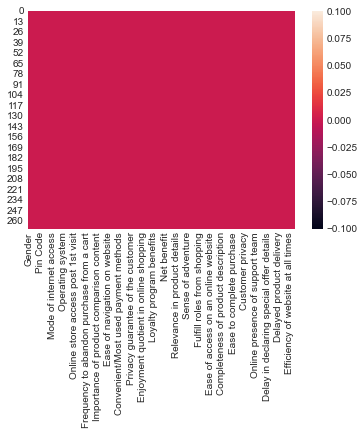

In [175]:
# checking nullvalue using heatmap
sns.heatmap(data=df1.isnull())

We can see from the heatmap visual that there are no missing values in any of the rows, and all 71 columns are filled with some sort of data.

In [176]:
df1.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Gender,269,2,Female,181,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Age,269,5,31-40 years,81,NaN,NaN,NaN,NaN,NaN,NaN,NaN
City,269,11,Delhi,58,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Pin Code,269.0,NaN,NaN,NaN,220465.747212,140524.341051,110008.0,122018.0,201303.0,201310.0,560037.0
Online Shopping Duration,269,5,Above 4 years,98,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Onine purchase in past 1 year,269,6,Less than 10 times,114,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Mode of internet access,269,4,Mobile internet,142,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Device used for internet access,269,4,Smartphone,141,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Screen size of mobie,269,4,Others,134,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Operating system,269,3,Window/windows Mobile,122,NaN,NaN,NaN,NaN,NaN,NaN,NaN


We can plainly see our column information with the aid of the describe method in transposition format. The count column verifies that our dataset does not have any missing data concerns. In addition, I utilised the describe method's include all option to guarantee that all columns are displayed, regardless of whether they are numeric or text data columns.

In [177]:
# checking information of datatype using info()
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 269 entries, 0 to 268
Data columns (total 71 columns):
 #   Column                                                         Non-Null Count  Dtype 
---  ------                                                         --------------  ----- 
 0   Gender                                                         269 non-null    object
 1   Age                                                            269 non-null    object
 2   City                                                           269 non-null    object
 3   Pin Code                                                       269 non-null    int64 
 4   Online Shopping Duration                                       269 non-null    object
 5   Onine purchase in past 1 year                                  269 non-null    object
 6   Mode of internet access                                        269 non-null    object
 7   Device used for internet access                                269 non-

From the above we can see that only 1 column (Pin code) is int64 and remaining all were object datatype.

In [178]:
#cheking unique values

df1.nunique().to_frame('Unique values')

,Unique values
Gender,2
Age,5
City,11
Pin Code,39
Online Shopping Duration,5
Onine purchase in past 1 year,6
Mode of internet access,4
Device used for internet access,4
Screen size of mobie,4
Operating system,3


In [179]:
#checking total unique value count
df1.nunique().sum()

456

Nunique shows us a list of the total number of unique values in each column of our dataframe in the cell above.

In [180]:
# storing column names into list
obj_columns = [] #variable

for i in df1.dtypes.index:
    if df1.dtypes[i] == "O":
        obj_columns.append(i)

In [181]:
#checking stored data names of list columns
obj_columns

['Gender',
 'Age',
 'City',
 'Online Shopping Duration',
 'Onine purchase in past 1 year',
 'Mode of internet access',
 'Device used for internet access',
 'Screen size of mobie',
 'Operating system',
 'Browser',
 'Channel used for 1st visit',
 'Online store access post 1st visit',
 'Time invested to explore and purchase',
 'Preferred payment option',
 'Frequency to abandon purchase from a cart',
 'Reason to abondant purchase from a cart',
 'Shopping website content readability',
 'Importance of product comparison content',
 'Importance of seller and product detail for purchase decision',
 'Clarity on relevant information for products',
 'Ease of navigation on website',
 'Loading and processing speed of website',
 'Ease of access on GUI of website',
 'Convenient/Most used payment methods',
 'On time product delivery',
 'Empathy towards the customer',
 'Privacy guarantee of the customer',
 'Support availability via various means',
 'Offers and Discounts on online shopping',
 'Enjoyment 

In [182]:
len(obj_columns) #checking total no of columns saved

70

For ease of access in later analysis, I've saved the renamed object datatype column names in a list in one variable. The column "Pin Code" is the only one that has an integer datatype.

In [183]:
# listing all Categorical data using for_loop method
for x in obj_columns:
    print(x)
    print(df1[x].value_counts())
    print("-"*70)

Gender
Female    181
Male       88
Name: Gender, dtype: int64
----------------------------------------------------------------------
Age
31-40 years           81
21-30 years           79
41-50 yaers           70
Less than 20 years    20
51 years and above    19
Name: Age, dtype: int64
----------------------------------------------------------------------
City
Delhi            58
Greater Noida    43
Noida            40
Bangalore        37
Karnal           27
Solan            18
Ghaziabad        18
Gurgaon          12
Merrut            9
Moradabad         5
Bulandshahr       2
Name: City, dtype: int64
----------------------------------------------------------------------
Online Shopping Duration
Above 4 years       98
2-3 years           65
3-4 years           47
Less than 1 year    43
1-2 years           16
Name: Online Shopping Duration, dtype: int64
----------------------------------------------------------------------
Onine purchase in past 1 year
Less than 10 times    114
31-40 time

I've highlighted all of the categorical data column values so that we can see which ones are unique and how many rows they fill in our dataframe.

# Visualization

In [184]:
pandas_profiling.ProfileReport(df1)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

pandas-profiling is an open source Python module that allows us to perform exploratory data analysis in a matter of minutes with just a few lines of code. It creates interactive online reports that may be delivered to anybody, even if they have no programming experience. It also provides report production for the dataset, with a variety of features and customizations. In other words, pandas-profiling saves us the time and effort of seeing and comprehending each variable's distribution. It creates a report with all of the data in one place.

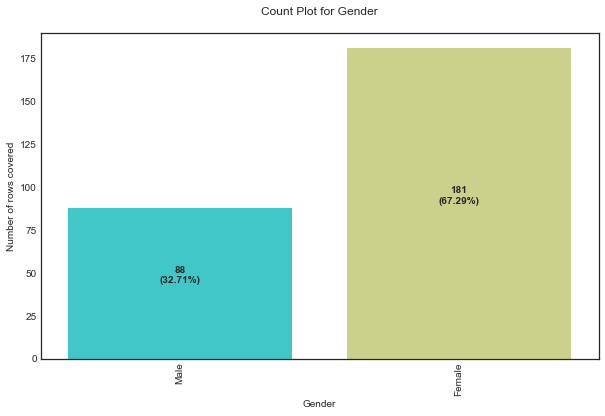

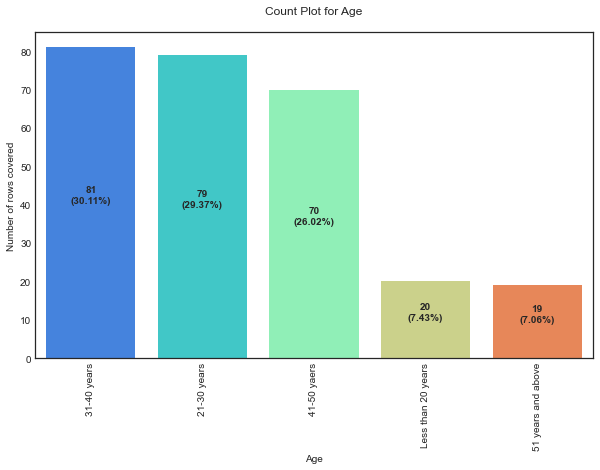

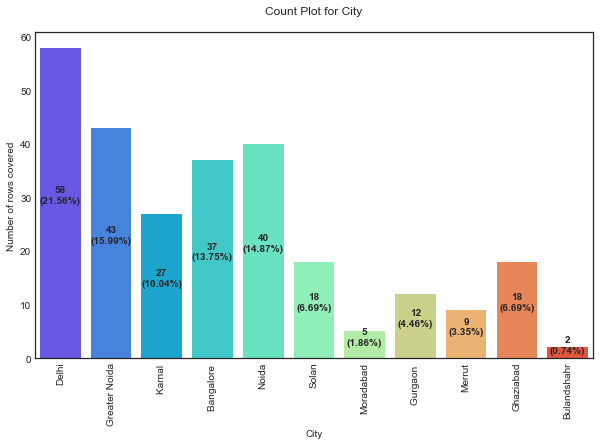

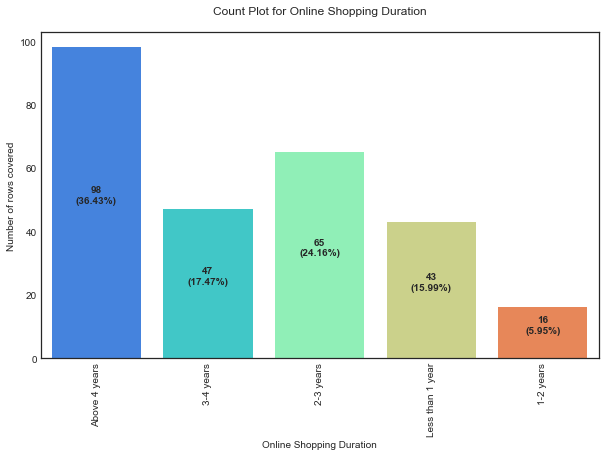

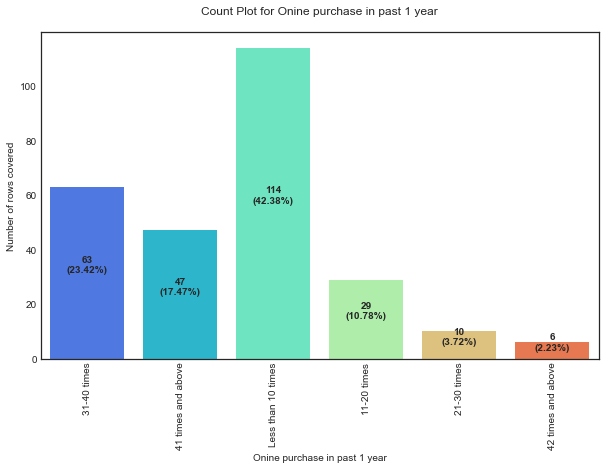

...

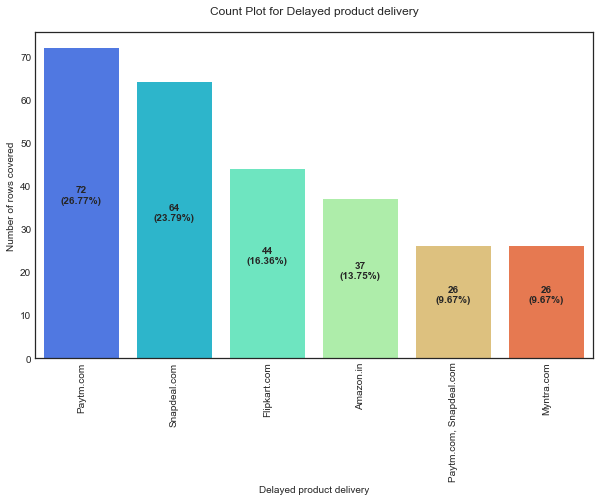

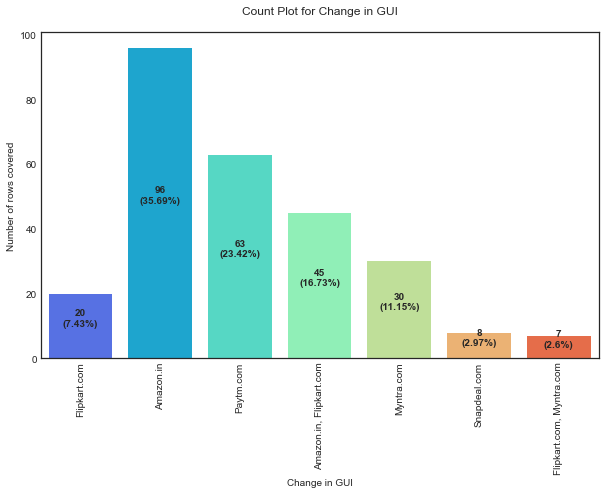

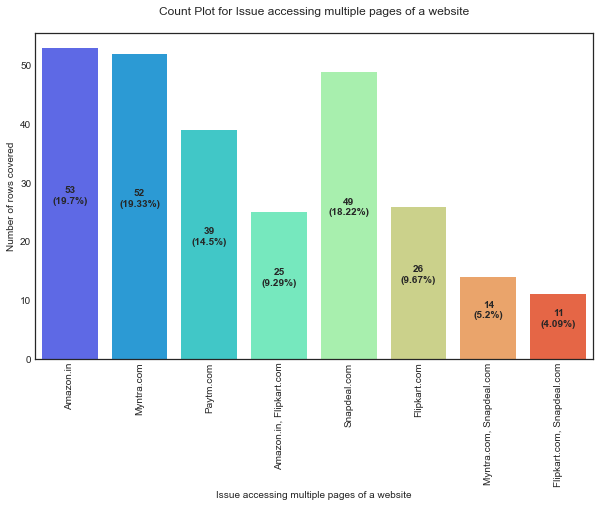

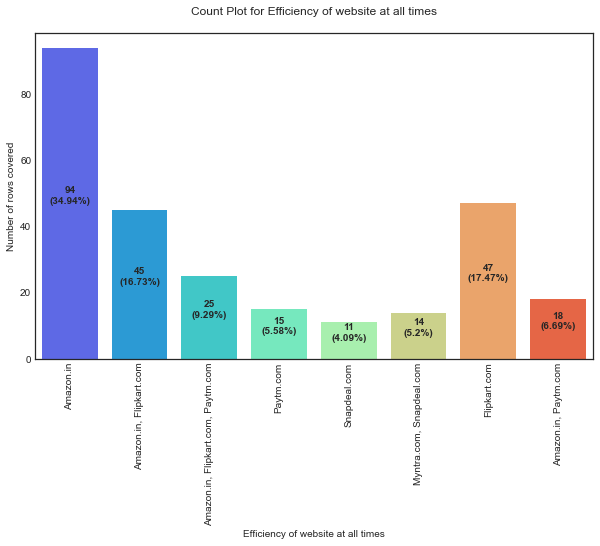

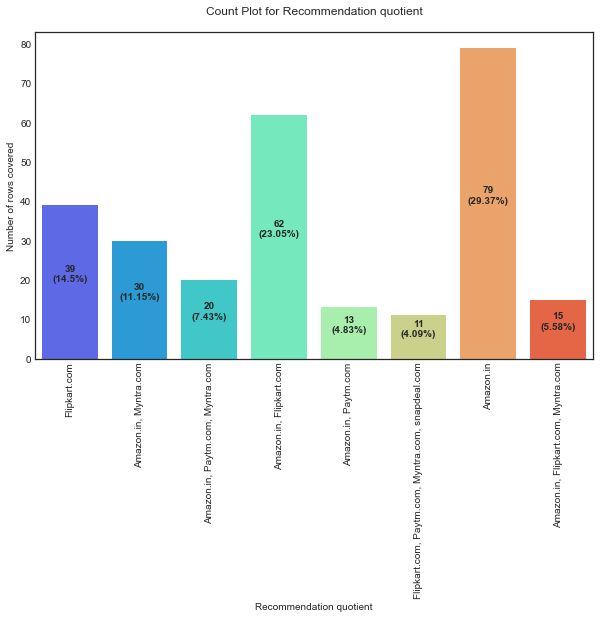

In [185]:
for C in df1[obj_columns]:
    plt.figure(figsize=(10,6))
    col_name = C
    values = df1[col_name].value_counts()
    index = 0
    ax = sns.countplot(df1[col_name], palette="rainbow")

    for i in ax.patches:
        h = i.get_height() #Count of each value
        t = len(df1[col_name]) # Total no of records using length
        s = f"{h}\n({round(h*100/t,2)}%)" #Displaying in count bar
        plt.text(index, h/2, s, ha="center", fontweight="bold")
        index += 1
    
    plt.title(f"Count Plot for {col_name}\n")
    plt.xlabel(col_name)
    plt.ylabel(f"Number of rows covered")
    plt.xticks(rotation=90)
    plt.show()

### Observations:

* For online buying, the pin code 201308 (Uttar Pradesh) has the most counts.

* In the Dataset, female buyers had a higher count than male buyers.

* For online purchasing, buyers between the ages of 31 and 40 are the most common, followed by those between the ages of 21 and 30.

* The city of Delhi has the most purchasers, followed by Greater Noida and Noida. The city of Bulandshahr has a small number of internet shoppers.

* Since 4+ years, the majority of purchasers have favoured internet purchasing.

* In the previous year, the majority of internet shoppers purchased less than ten things.

* Using a cellphone The internet is used mostly for online commerce.

* The smart phone is the most popular device for internet shopping, followed by the laptop.

* Smartphones with screens larger than 4.7, 5.5, and 5 inches were used more frequently for online shopping.

* Windows-based devices have been the most popular for online shopping, followed by Android-based devices.

* When compared to other browsers, Google Chrome is utilised the most to access the website.

* The search engine is more valuable for potential online purchasers, and the search engine has been used more to locate the website after the first visit to the business.

* Buyers often study a website for more than 15 times before making a purchase decision.

* For online purchases, credit/debit cards have been utilised more than other methods.

* Because of a superior alternative offer, the majority of buyers prefer to add the goods to their basket and depart without paying.

* The website's content and all important information are simple to read and comprehend, as well as simple to navigate for a large number of online buyers.

* For product comparison, the majority of respondents strongly think that information about a similar product to the one highlighted is critical.

* For buying choices, the majority of individuals strongly think that accurate information on the listed sellers and the goods being provided is critical.

* The majority of customers believe that a website's loading and processing time should be rapid, making it user-friendly.

* The payment method is a vital aspect in retaining customers when making online purchases, and purchasers trust that online retailers will complete their share of the transaction on time.

* Consumer service and customer privacy are particularly vital to retain customers, according to a large proportion of buyers.

* Customers who shop online receive monetary rewards and discounts on the products they purchase, and they return to the website to shop for more since it is a good value for money.

* The majority of consumers prefer internet shopping since it is more convenient and simple to use.

* The majority of purchasers feel that the return and replacement policy is critical when making a purchase.

* People unanimously agreed that one of the advantages of internet purchasing is the ability to participate in loyalty programmes.

* The majority of purchasers feel that providing great information on the website promotes consumer happiness and trust.

* Offering a diverse range of items in a variety of categories, together with accurate information, aids in client retention.

* Online purchasing on a regular basis creates a sense of adventure.

* Shopping at your favourite e-tailer raises your social status while attracting the largest amount of customers.

* The majority of buyers believe that shopping from a preferred e-tailer is acceptable.

* The majority of consumers choose to purchase on Amazon.in, Flipkart.com, Paytm.com, Myntra.com, and Snapdeal.com because they are more user-friendly.

* According to the poll, Amazon.in and flipkart.com have the most aesthetically attractive web page layouts.

* Amazon.in and Flipkart.com both provide a large selection of items and offers.

* Amazon.in and Flipkart.com include comprehensive product descriptions and information.

* Amazon is the top in terms of trustworthiness/reliability, speed of purchase completion, and website and application loading speed.

* Amazon and Flipkart.com both provide a variety of payment choices, however Snapdeal just offers a few.

* In terms of product delivery and security of consumer information, Amazon ranks first, followed by Flipkart.com, while Paytm takes longer to deliver things.

* The finest customer service is provided by Amazon.in, followed by Flipkart.com, Myntra.com, and Snapdeal.

* Flipkart.com takes less time to log in (due to a promotion or a discount period), whereas Amazon.in takes a lengthy time.

* When it comes to showing graphics and photographs (promotions, sales periods), Amazon.in and flipkart.com load slower.

* Myntra took a lengthy time to announce its discount pricing and offers, while paytm.com took a long time to load.

* As Amazon regularly interrupts when switching from one page to another, it updates/changes the look of its website/application over time, yet it continues to function as effectively as previously.

* Amazon is the most popular Indian internet store, followed by Flipkart.

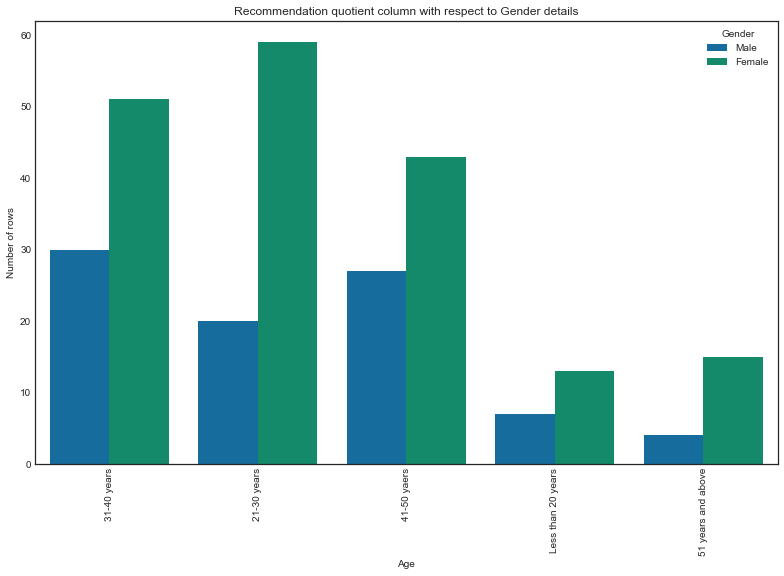

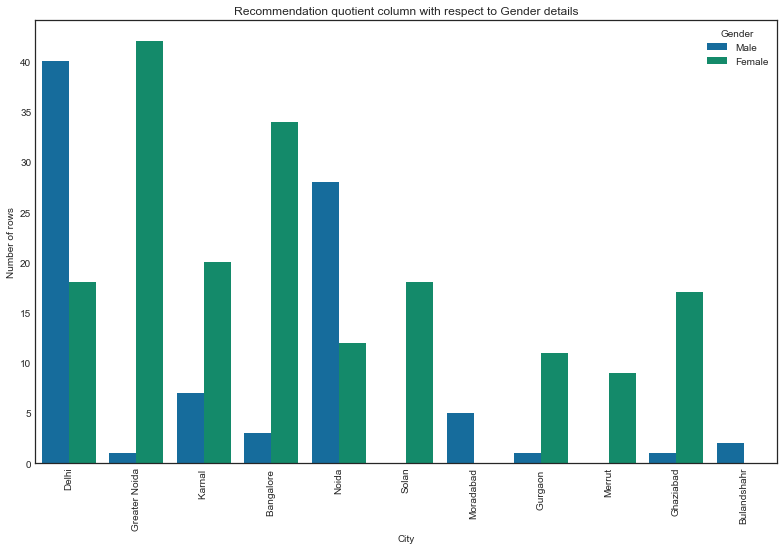

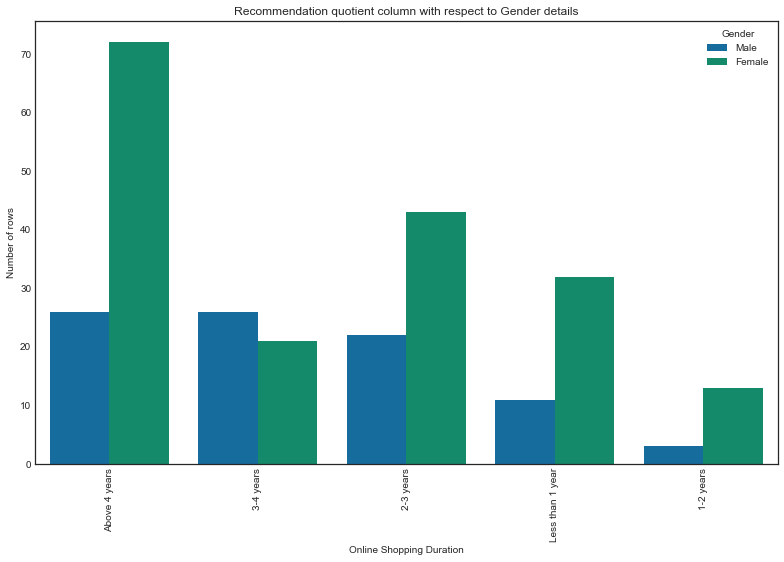

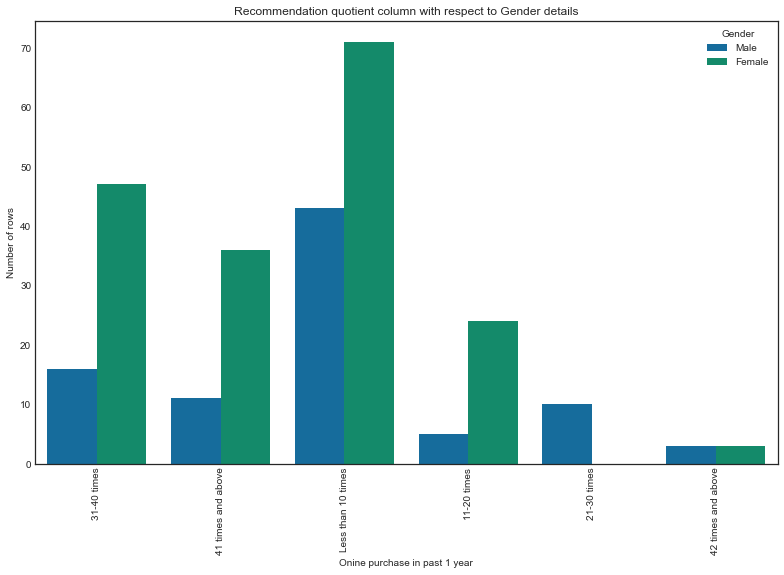

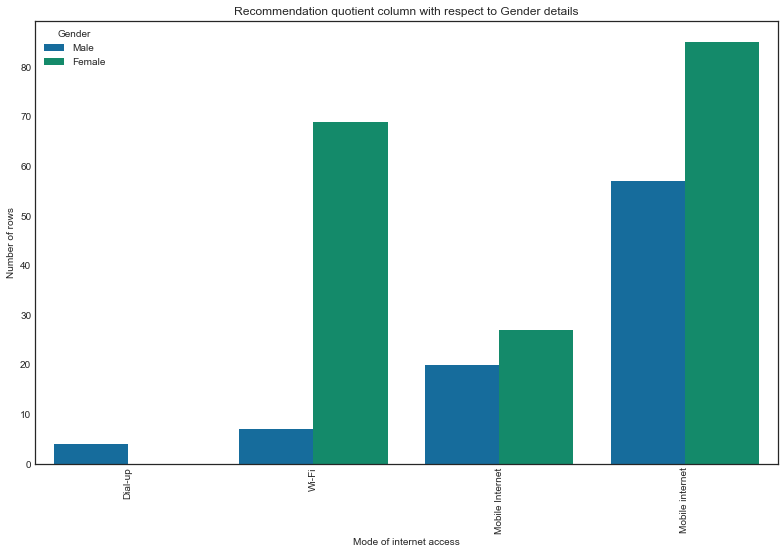

...

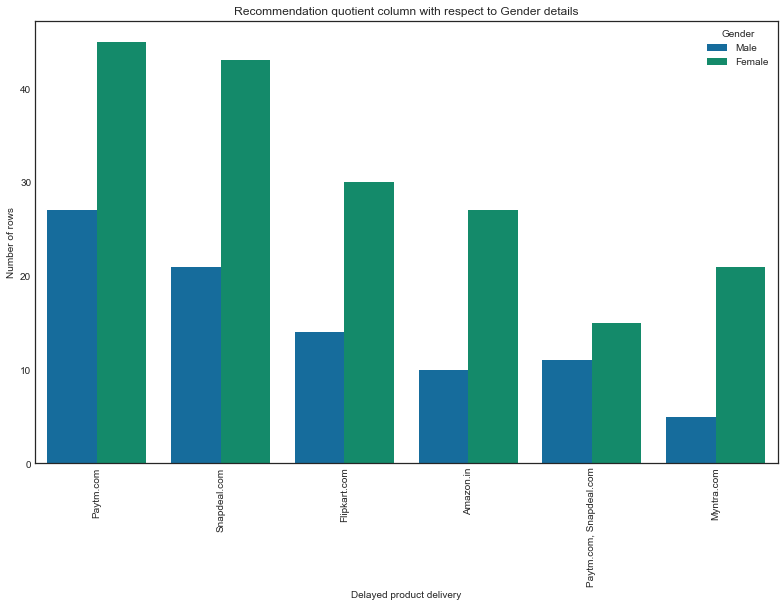

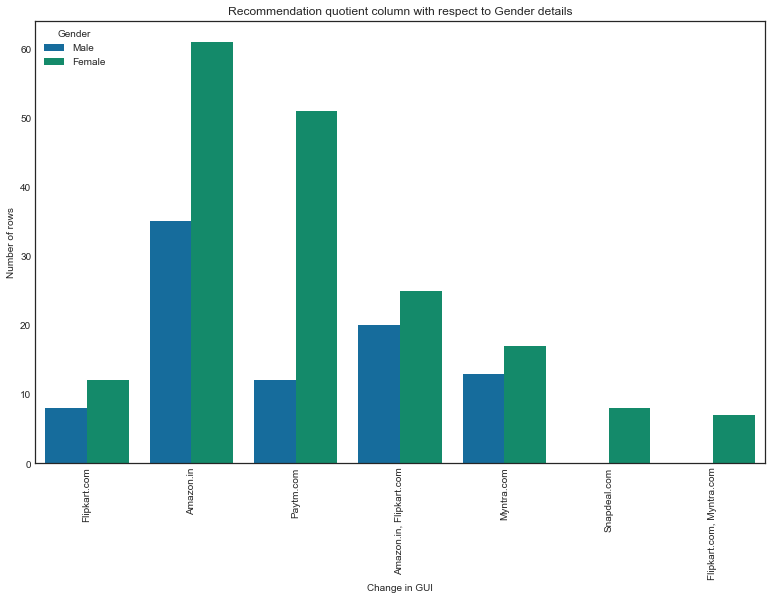

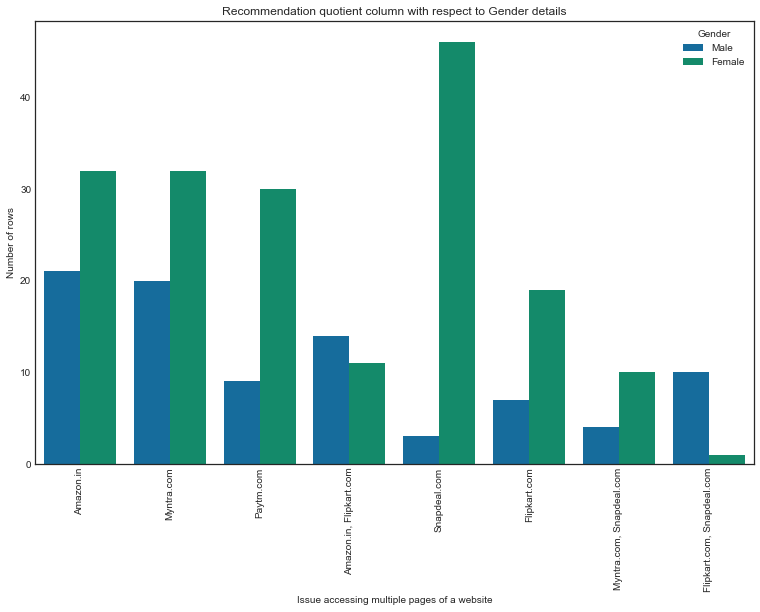

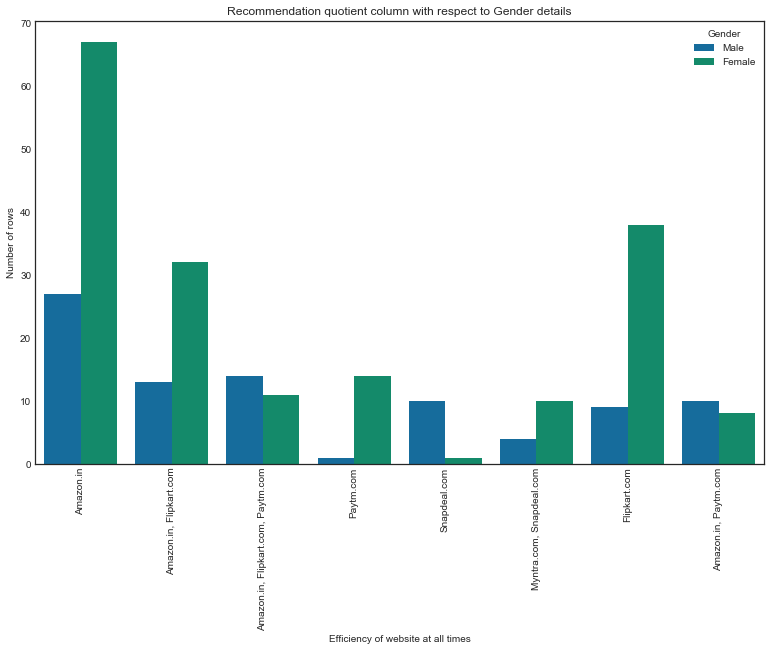

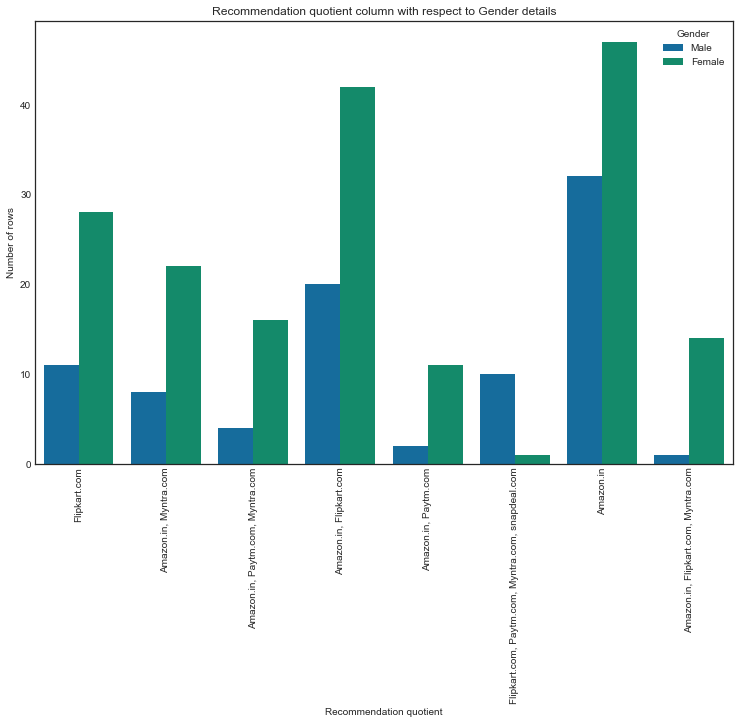

In [186]:
for C in df1:
    if C == "Gender":
        pass
    elif C == "Pin Code":
        pass
    else:
        plt.style.use('seaborn-white')
        plt.figure(figsize=(11,7))
        sns.countplot(x=C, data=df1, hue="Gender")
        plt.title("{} column with respect to Gender details".format(col))
        plt.tight_layout()
        plt.xticks(rotation=90)
        plt.ylabel("Number of rows")
        plt.show()

### Observations:

* Female and male respondents who are 41-50 years old and less than 20 years old do not differ significantly in their count.

* Many of the responders from Bangalore and Greater Noida are female.

* Many of the responses from Noida and Delhi are men.

* The number of men and women purchasing from their computers is about equal. Women, on the other hand, are more likely to shop on their smartphones or laptops.

* The majority of women return to shopping websites using a search engine.

* Rather than using a straight URL, many women choose to utilise a search engine or an app. Men, on the other hand, use search engines, URLs, and apps a little less. As a result, we may deduce that women utilise apps more than males.

* Women spend more time online shopping than males, with the average time being more than 15 minutes, followed by 11-15 minutes.

* Women, too, compare items to those on other websites, which is one of the reasons they abandon their shopping carts.

* More loyalpoints are preferred by women than by males.

* More women disagree with the notion that internet buying is an adventure. Since a result, websites should strive to provide real-time experiences, as this may be a powerful marketing tactic.

* Online purchasing does not seem to fulfil certain tasks for women.

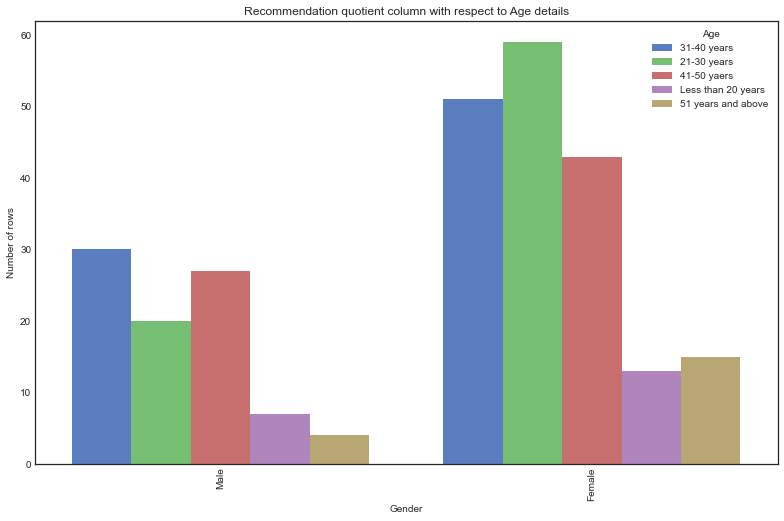

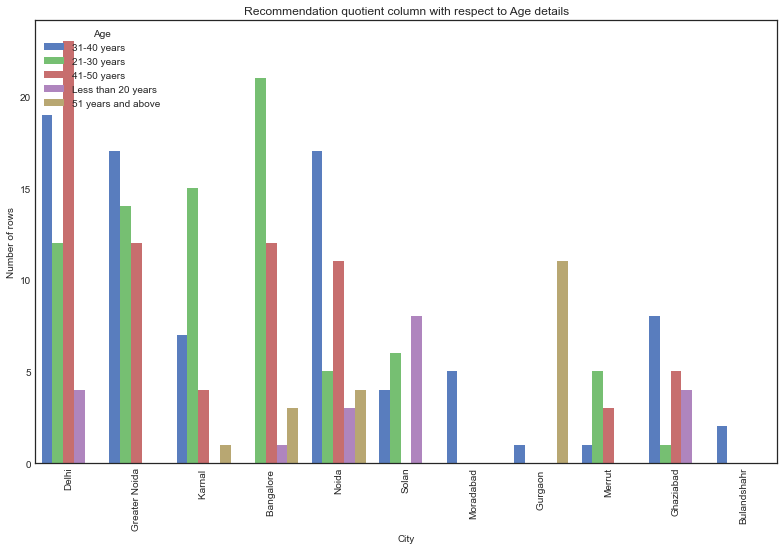

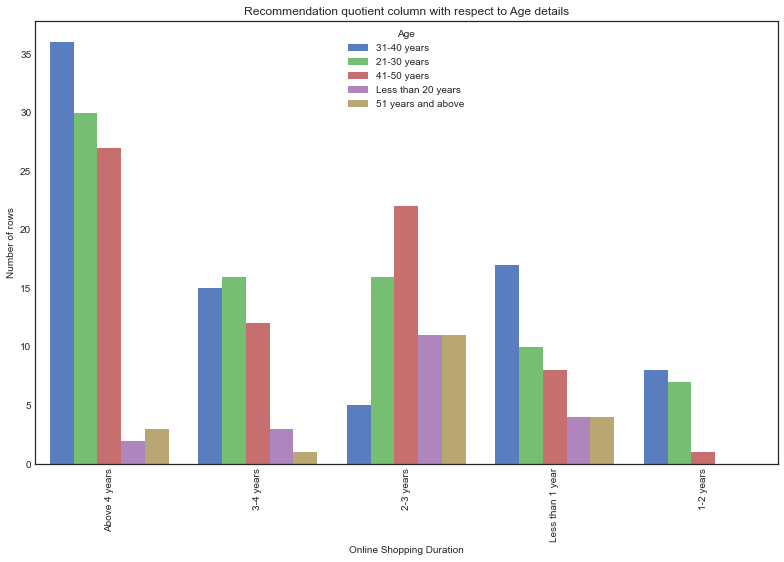

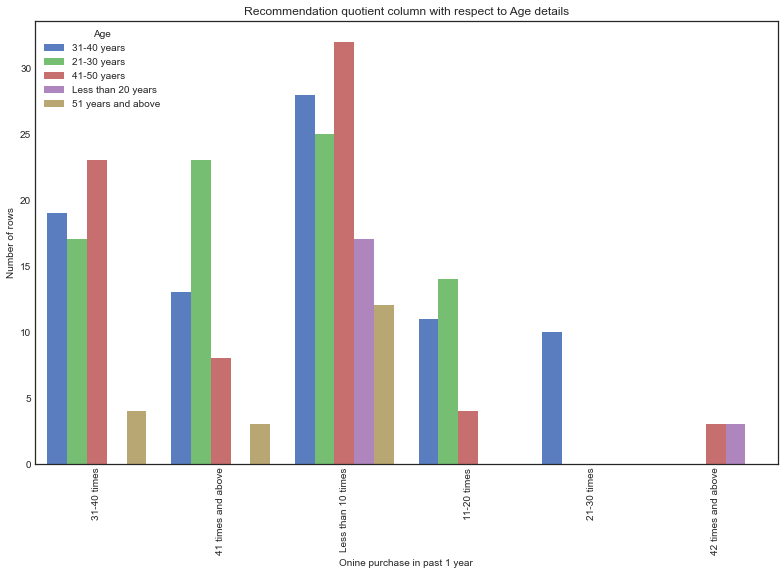

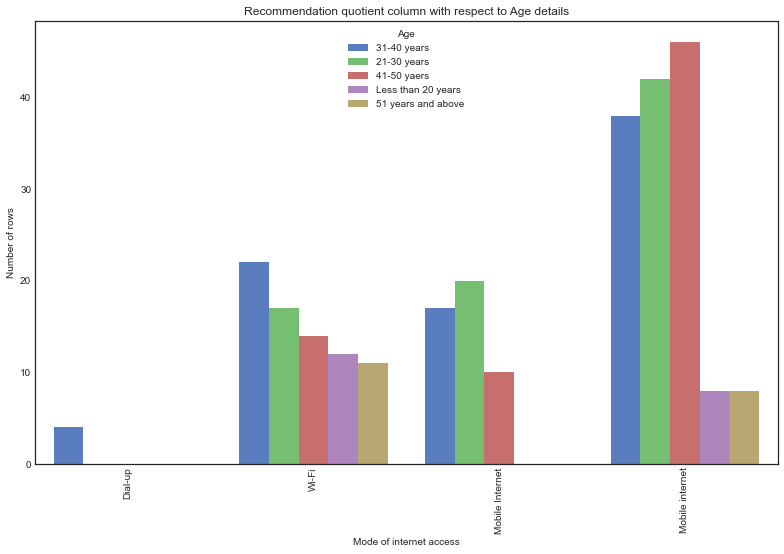

...

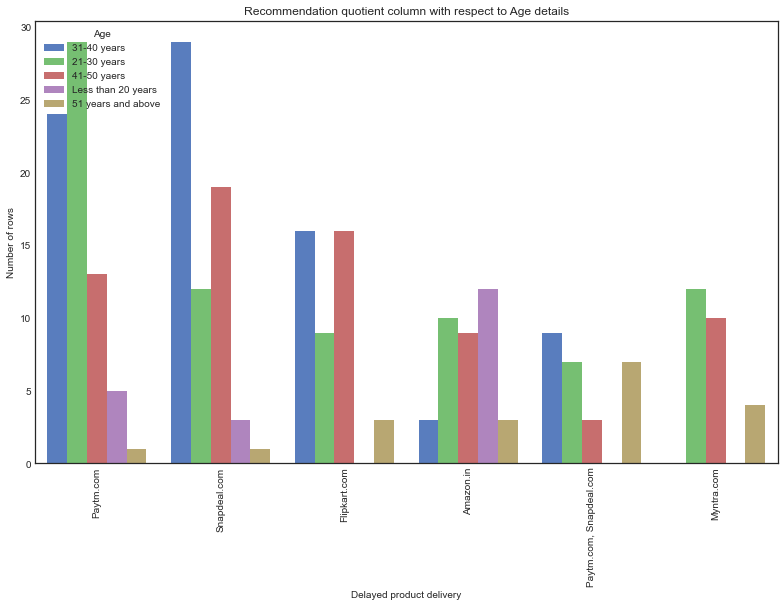

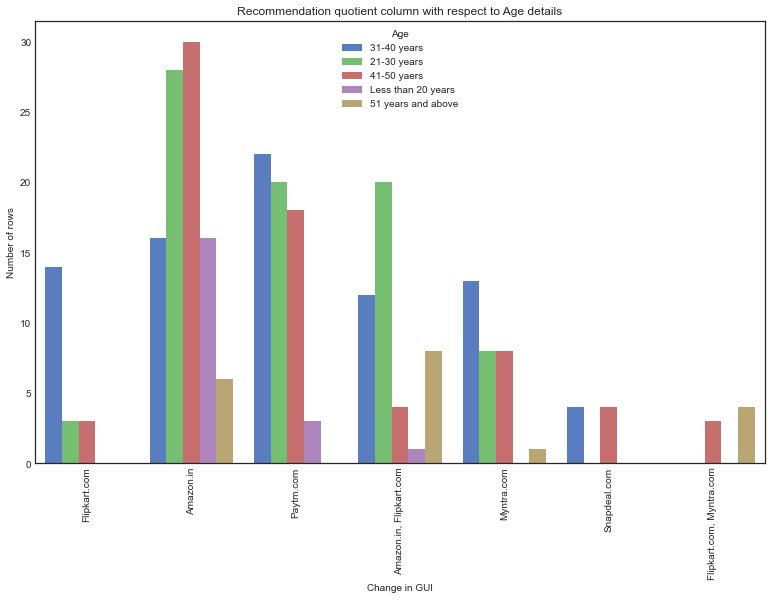

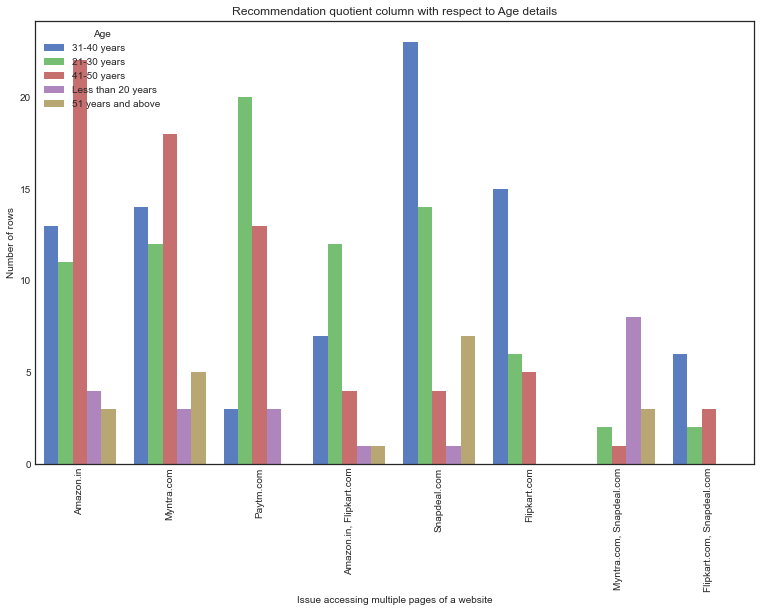

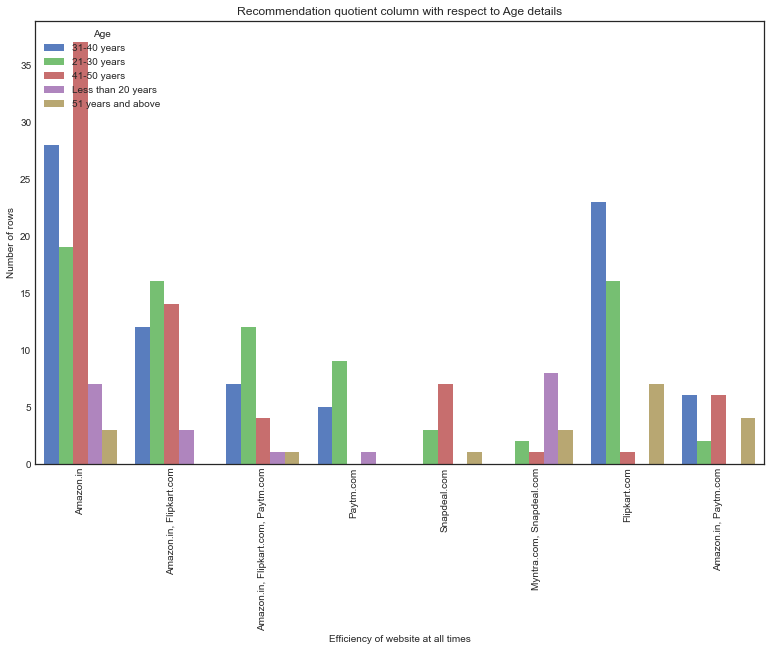

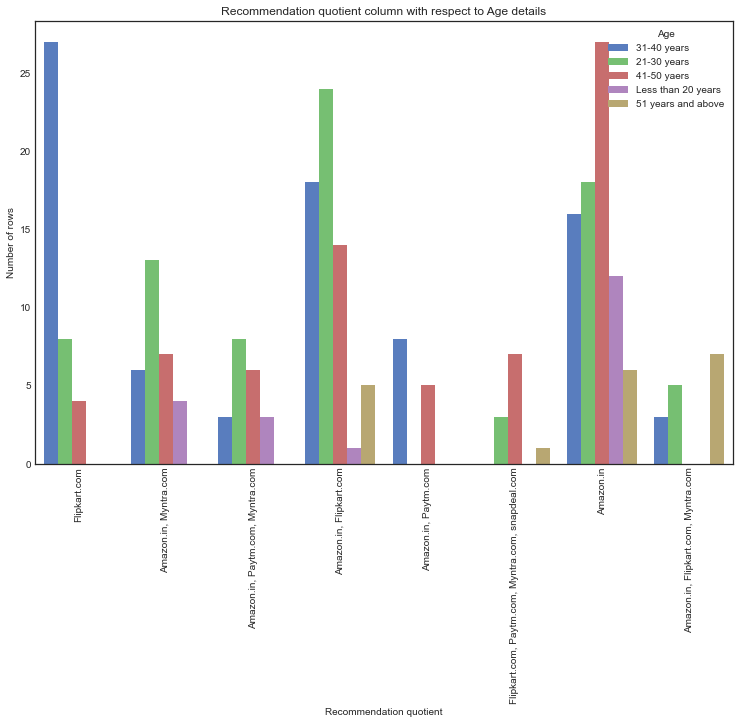

In [187]:
for C in df1:
    if C == "Age":
        pass
    elif C == "Pin Code":
        pass
    else:
        plt.style.use('seaborn-muted')
        plt.figure(figsize=(11,7))
        sns.countplot(x=C, data=df1, hue="Age")
        plt.title("{} column with respect to Age details".format(col))
        plt.tight_layout()
        plt.xticks(rotation=90)
        plt.ylabel("Number of rows")
        plt.show()

### Observations:

* I may claim that males are fewer and females are more, which suggests that females shop more.

* People in their twenties, thirties, and forties used to shop more, whereas those in their fifties and sixties used to buy relatively little.

* How long have you been shopping online? I believe that youngsters as young as four years old begin to purchase online.

* I may say that if you have made an online purchase fewer than 10 times in the last year, you have a high count, and if you have made an online purchase 42 times or more, you have a low count, which suggests that most individuals buy less than 10 mines every year.

* People are more likely to buy using mobile internet than dialup, according to How do you access the internet while buying on-line.

* Which gadget do you use to perform your online shopping from? I believe that people use their cellphones more than their computers, and that just a small percentage of people utilise tablets.

* What is the size of the screen on your mobile device? Other people have the greatest count of 5.5 inches and the smallest count of 5 inches.

* What is the name of your device's operating system (OS)? For in-store shopping, I'd say the majority of consumers use Windows phones, followed by Android, and then iOS.

* What browser do you use to view the website on your device? I'd argue that the majority of users use Google Chrome and that just a small percentage of individuals use Firefox.

* Which route did you take to reach your favourite online retailer for the first time? The majority of people utilise search engines to make purchases.

* How do you go to an online retail business after your initial visit? I believe this was accomplished through the use of a search engine or an app.

* From How long do you spend exploring an e-commerce shop before making a buy decision? I'd guess the majority of individuals spend 15 minutes and only a few people spend one minute.

* What payment method do you prefer? People prefer credit/debit cards, followed by cash on delivery, and last, electronic wallets.

* I can claim that the greatest count has occasionally and the lowest count has very regularly abandoned (selecting things and departing without making payment) your shopping basket.

* From the reasons for abandoning a shopping cart purchase, I can say that a better offer has a high count, indicating that people have found a better offer, and a lack of trust and no preferred payment has a low count, indicating that people lack trust and have not found their preferred payment method.

* People who strongly agree and agree that the material on the website must be easy to read and comprehend have voted more for highly agree and agree that they want to be able to read the content of the site while shopping.

* People have voted highly agree and agree that information on comparable products to the one highlighted is useful for product comparison.

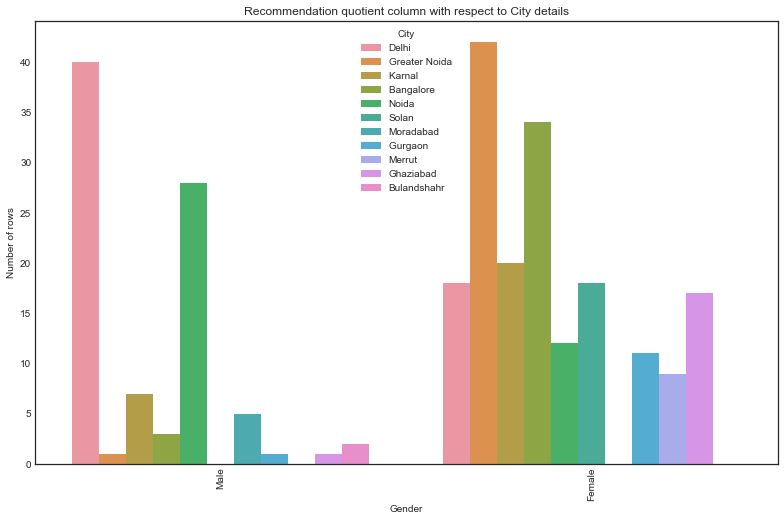

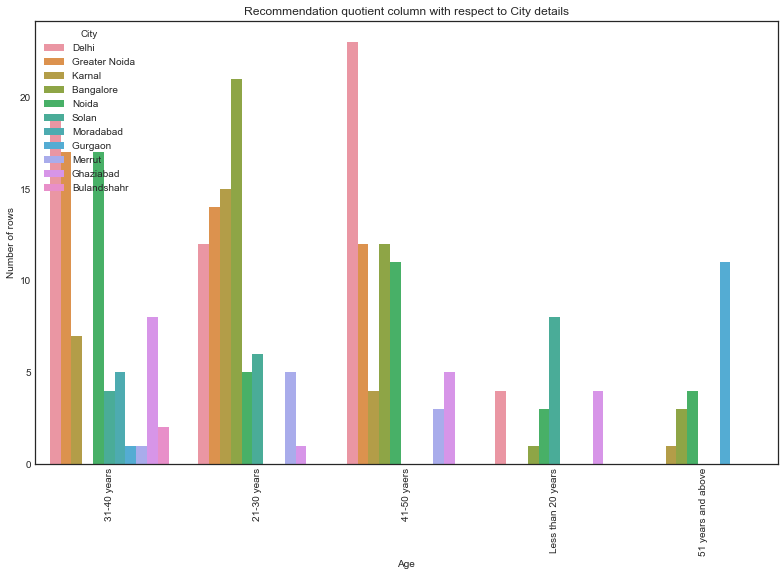

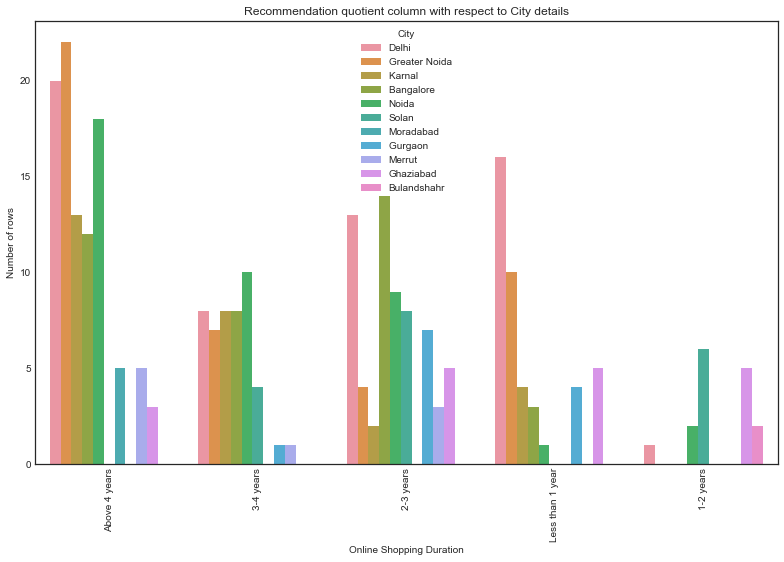

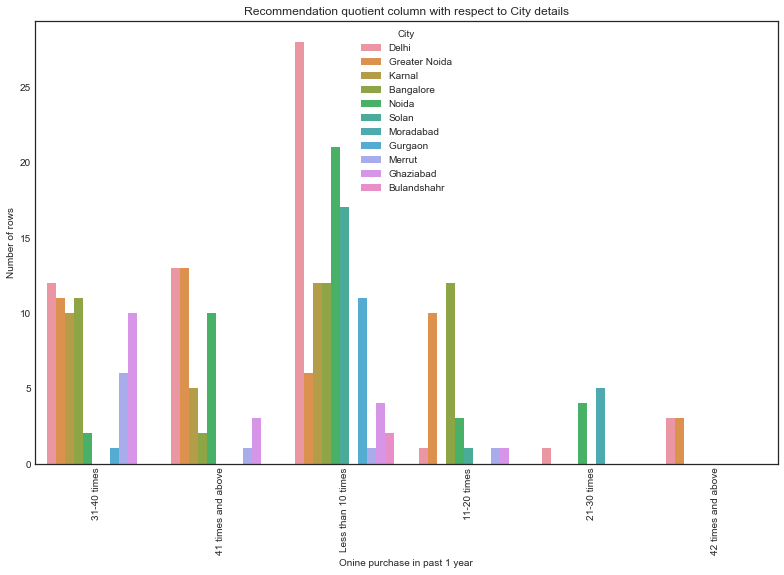

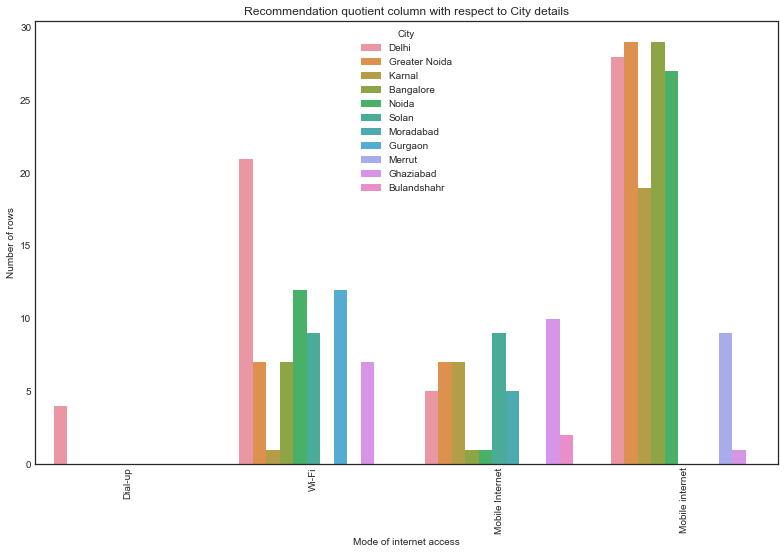

...

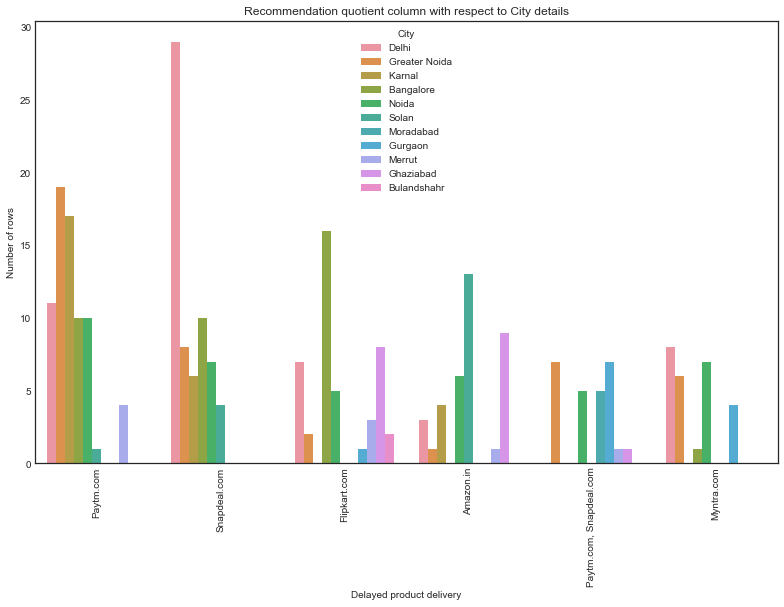

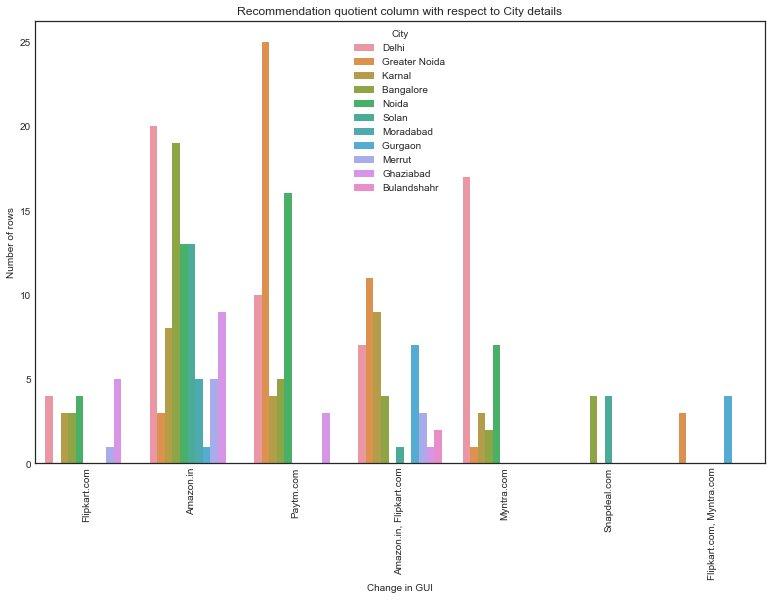

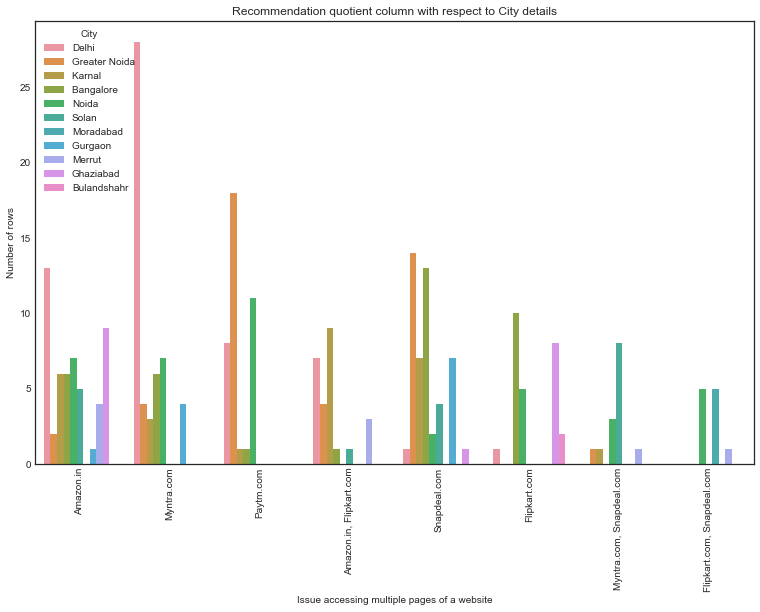

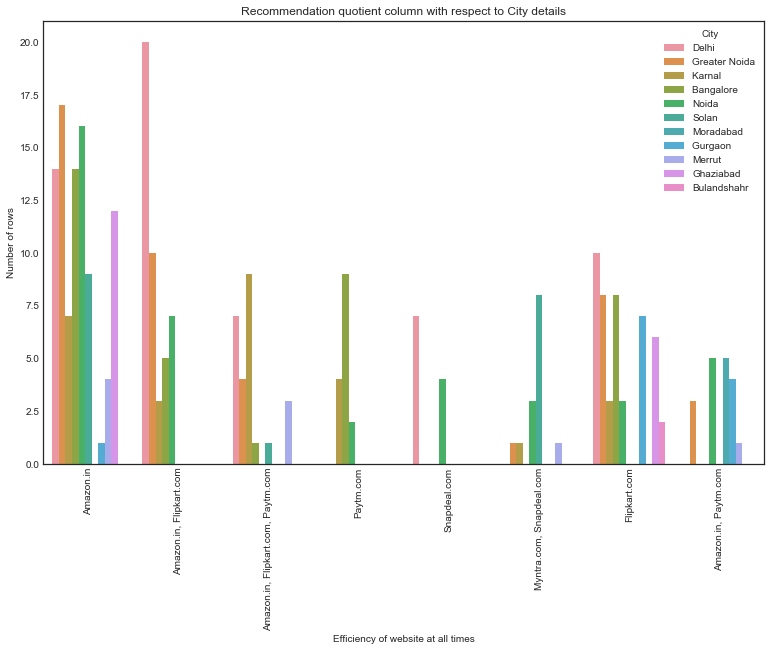

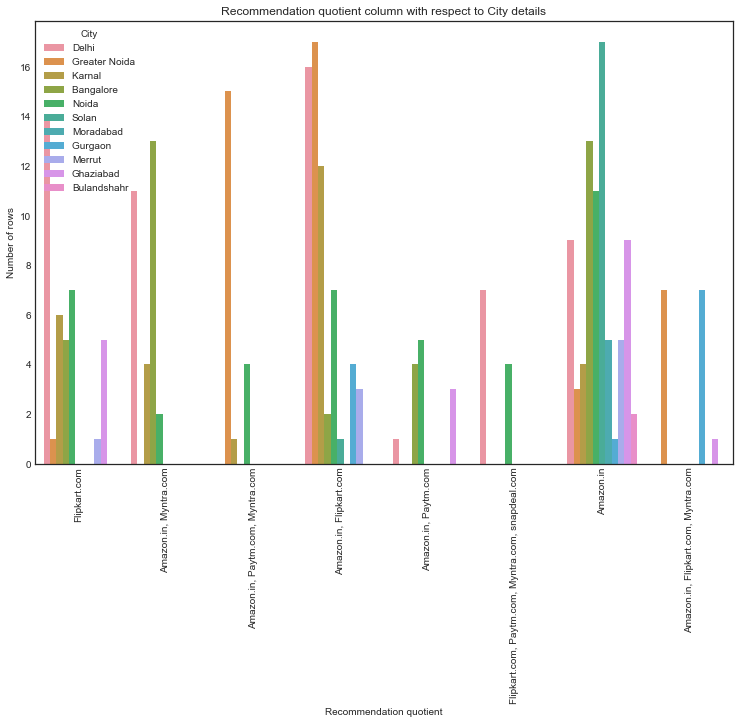

In [188]:
for C in df1:
    if C == "City":
        pass
    elif C == "Pin Code":
        pass
    else:
        plt.style.use('seaborn-colorblind')
        plt.figure(figsize=(11,7))
        sns.countplot(x=C, data=df1, hue="City")
        plt.title("{} column with respect to City details".format(col))
        plt.tight_layout()
        plt.xticks(rotation=90)
        plt.ylabel("Number of rows")
        plt.show()

### Observations :

* There are more female respondents than male ones. It's possible that data collecting focuses mostly on women.

* The respondents were divided into three groups: those aged 21-40, 41-50, and those aged less than 20. We may deduce that the majority of the correspondents are from the working class.

* The majority of the respondents live in Delhi, Greater Noida, Noida, and Bangalore.

* The majority of people have been purchasing online for more than four years. There are a significant number of people who have been buying online for less than a year, and statistics show that many new consumers are added each year.

* We can see that many people have only shopped 10 times in the last year.

* Many of them purchase online using their smartphones, followed by laptops, desktops, and tablets.

* The most common operating system on consumer devices is Windows, followed by Android and Mac.

* The most popular browser for accessing the shopping website is Google Chrome.

* People are using search engines to become clients of their favourite shops. When it comes to internet marketing, content marketing and display adverts aren't as effective. As a result, businesses should spend more money on search engine advertising.

* People prefer to utilise a search engine first, then an app, and finally a direct URL for recurrent visits. We can see that the distinction between the app and the search engine is minor.

* Before making a purchase, the majority of individuals spend more than 15 minutes, followed by 6-10 minutes.

* Credit/debit cards are the most common payment method, followed by COD and e-wallets.

* People have stated that they occasionally abandon their shopping carts without making a purchase, and that the main reason for this is that they are looking for a better alternative deal. It indicates that before making a purchase, individuals are checking prices from a variety of online stores.

* Customers unanimously agree that website content must be simple to read and comprehend.

* The majority of buyers want to know about comparable items before making a purchase.

* The majority of clients desire detailed information on the listed vendors and the items they are selling.

* Customers demand all relevant information about the offered items, and only a small percentage of them disagree.

* Customers sought websites that were simple to use.

* The majority of consumers want fast loading and processing times, a user-friendly website interface, a convenient payment option, a high level of confidence in the website, empathy for customers, customer privacy assurance, responsiveness-availability of several contact channels, and so on.

* People believe that internet buying provides them with a variety of advantages and discounts.

* Customers also like how convenient and flexible buying online is.

* For many buyers, the return policy is critical in determining whether or not to purchase a product.

* Many clients believe that purchasing online saves them money due to cost and discount reasons.

* Customers are less concerned with aspects like as pleasure, social status gain as a result of purchasing, or if shopping online provides a thrill or adventure. As a result, there is a lot of room to improve the client experience in this area.

# Encoding the categorical object datatype columns

In [189]:
# Ordinal Encoding

oe = OrdinalEncoder()

def ordinal_encode(df, column):
    df[column] = oe.fit_transform(df[column])
    return df

oe_col = df1.columns
df=ordinal_encode(df1, oe_col)
df.head()

,Gender,Age,City,Pin Code,Online Shopping Duration,Onine purchase in past 1 year,Mode of internet access,Device used for internet access,Screen size of mobie,Operating system,Browser,Channel used for 1st visit,Online store access post 1st visit,Time invested to explore and purchase,Preferred payment option,Frequency to abandon purchase from a cart,Reason to abondant purchase from a cart,Shopping website content readability,Importance of product comparison content,Importance of seller and product detail for purchase decision,Clarity on relevant information for products,Ease of navigation on website,Loading and processing speed of website,Ease of access on GUI of website,Convenient/Most used payment methods,On time product delivery,Empathy towards the customer,Privacy guarantee of the customer,Support availability via various means,Offers and Discounts on online shopping,Enjoyment quotient in online shopping,Flexibity in online shopping,Return and Replacement policy,Loyalty program benefits,Quality of website content,User satisfaction,Net benefit,User satisfaction with trust factor,Wide range of products,Relevance in product details,Monetary savings,Frequency of purchase from a seller,Sense of adventure,Social status,Pleasure in shopping from a seller,Fulfill roles from shopping,Value for money,List of online shopping websites,Ease of access on an online website,Website layout,Variety of products on offer,Completeness of product description,Website access speed,Reliability of website,Ease to complete purchase,Payment option availability,Fast delivery,Customer privacy,Security on payment details,Trust worthiness,Online presence of support team,Time to login website on special offer days,Time to load media on special offer days,Delay in declaring special offer details,Time to load website on special offer days,Limited mode of payment on special offer days,Delayed product delivery,Change in GUI,Issue accessing multiple pages of a website,Efficiency of website at all times,Recommendation quotient
0,1.0,1.0,2.0,1.0,3.0,2.0,0.0,0.0,3.0,2.0,0.0,2.0,2.0,2.0,2.0,2.0,2.0,0.0,2.0,2.0,0.0,0.0,4.0,1.0,1.0,1.0,1.0,0.0,0.0,4.0,3.0,1.0,1.0,0.0,2.0,2.0,0.0,2.0,3.0,3.0,1.0,2.0,0.0,0.0,2.0,0.0,1.0,7.0,9.0,7.0,5.0,10.0,9.0,9.0,8.0,9.0,0.0,0.0,0.0,7.0,9.0,0.0,0.0,3.0,5.0,0.0,3.0,2.0,0.0,0.0,6.0
1,0.0,0.0,2.0,5.0,3.0,3.0,3.0,2.0,0.0,1.0,0.0,2.0,4.0,4.0,1.0,3.0,4.0,2.0,3.0,3.0,2.0,2.0,3.0,3.0,2.0,2.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,4.0,4.0,2.0,2.0,1.0,2.0,3.0,5.0,6.0,2.0,2.0,8.0,2.0,2.0,1.0,9.0,9.0,8.0,2.0,1.0,6.0,7.0,10.0,7.0,5.0,0.0,4.0,1.0,3.0
2,0.0,0.0,4.0,23.0,2.0,3.0,1.0,2.0,2.0,0.0,0.0,2.0,4.0,1.0,2.0,2.0,4.0,2.0,0.0,0.0,0.0,0.0,0.0,3.0,2.0,2.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,1.0,2.0,2.0,0.0,2.0,2.0,2.0,0.0,0.0,0.0,4.0,4.0,0.0,8.0,7.0,6.0,4.0,7.0,7.0,6.0,5.0,10.0,0.0,0.0,6.0,6.0,8.0,7.0,6.0,4.0,7.0,0.0,3.0,5.0,6.0,0.0,5.0
3,1.0,0.0,6.0,11.0,2.0,5.0,1.0,2.0,2.0,1.0,3.0,2.0,2.0,2.0,1.0,1.0,0.0,0.0,0.0,2.0,0.0,2.0,0.0,3.0,2.0,0.0,1.0,1.0,0.0,0.0,4.0,3.0,0.0,4.0,2.0,0.0,3.0,0.0,0.0,0.0,2.0,0.0,0.0,2.0,0.0,4.0,0.0,4.0,4.0,3.0,1.0,1.0,6.0,3.0,3.0,2.0,3.0,2.0,5.0,5.0,3.0,9.0,7.0,4.0,8.0,5.0,3.0,1.0,1.0,2.0,1.0
4,0.0,0.0,0.0,31.0,1.0,0.0,3.0,2.0,0.0,1.0,3.0,0.0,4.0,4.0,1.0,0.0,0.0,2.0,2.0,2.0,0.0,0.0,3.0,3.0,2.0,0.0,1.0,0.0,1.0,2.0,2.0,2.0,2.0,1.0,0.0,2.0,2.0,2.0,0.0,0.0,2.0,0.0,4.0,3.0,2.0,3.0,1.0,4.0,4.0,9.0,7.0,5.0,0.0,6.0,4.0,4.0,0.0,7.0,10.0,6.0,5.0,5.0,8.0,5.0,8.0,7.0,3.0,0.0,7.0,6.0,3.0


To convert categorical object datatype columns to numeric values, I used OrdinalEncoder. There was no sense in utilising label encoder because we didn't have any labels in our dataset. Furthermore, because our dataset has 71 columns, utilising One Hot Encoding would have resulted in an increase in the number of columns.

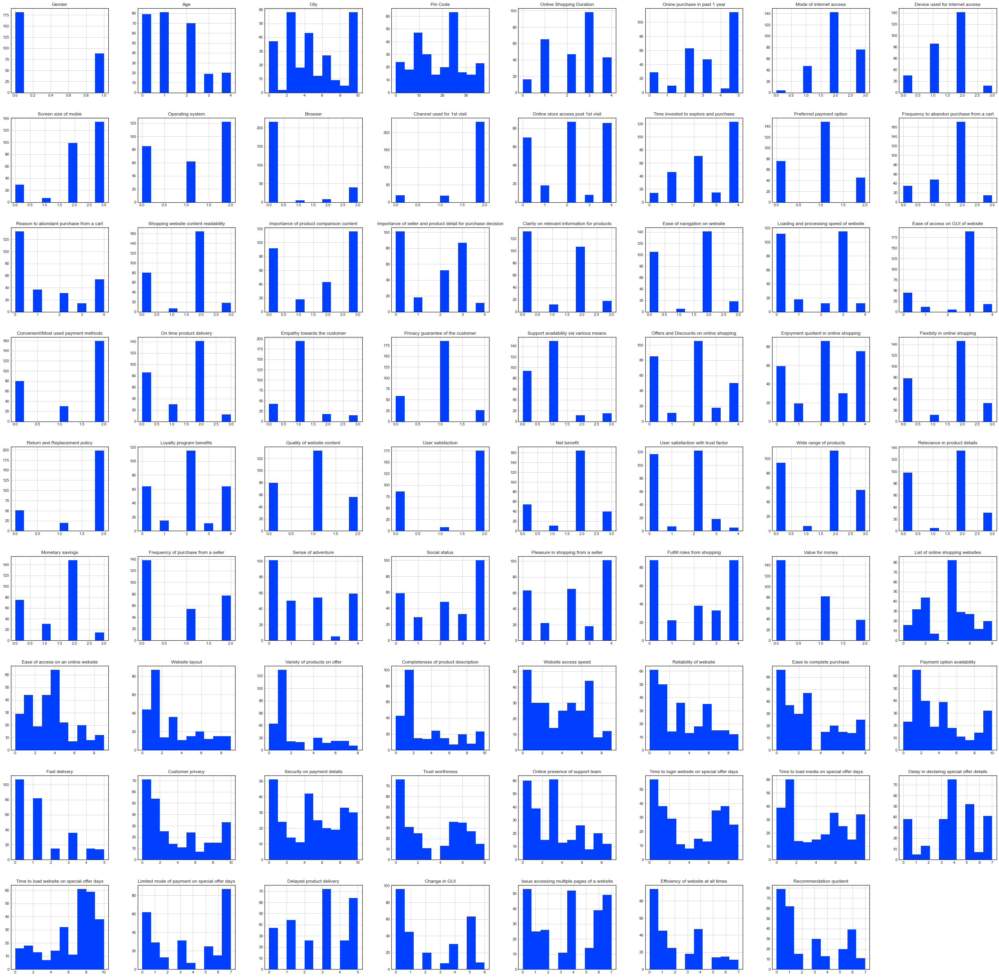

In [190]:
plt.style.use('seaborn-bright')

df.hist(figsize=(45,45))
plt.show()

### Conclusions:

* Females make up the majority of internet shoppers.

* The majority of people between the ages of 31 and 40 purchase online.

* The amount of people who purchase online is highest in Delhi.

* On the basis of consumer satisfaction, Amazon and Flipkart are the most reputable websites/applications for online purchasing.

* Paytm, Myntra, and Snapdeal all have room for improvement in terms of client happiness.

* Finally, Amazon is a highly recommended platform for online shopping because of its ease of use, high usage, and overall consumer happiness.

# Correlation

* A perfect positive correlation is shown by a correlation of +1, which means that both variables move in the same direction.

* A negative correlation of –1 implies a complete negative correlation, which means that when one measure rises, the other falls.

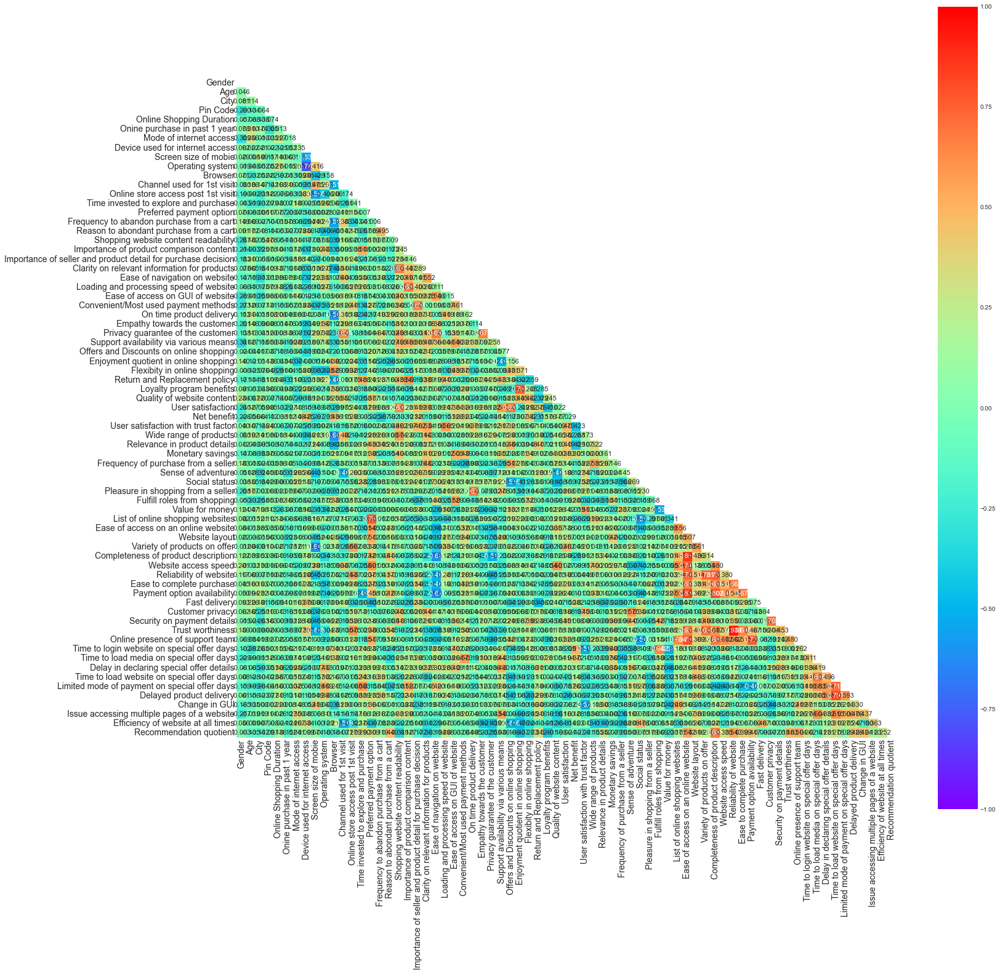

In [191]:
# using heatmap
upper_triangle = np.triu(df1.corr())
plt.figure(figsize=(24,24))
sns.heatmap(df1.corr(), vmin=-1, vmax=1, annot=True, square=True, fmt='0.3f', 
            annot_kws={'size':11}, cmap="rainbow", mask=upper_triangle)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.show()

We can't see the correlation details in the above heatmap owing to the large number of columns, but we can see the colour coding details and get a signal that there is no multicollinearity worry between the column values.

## Correlation Bar plot

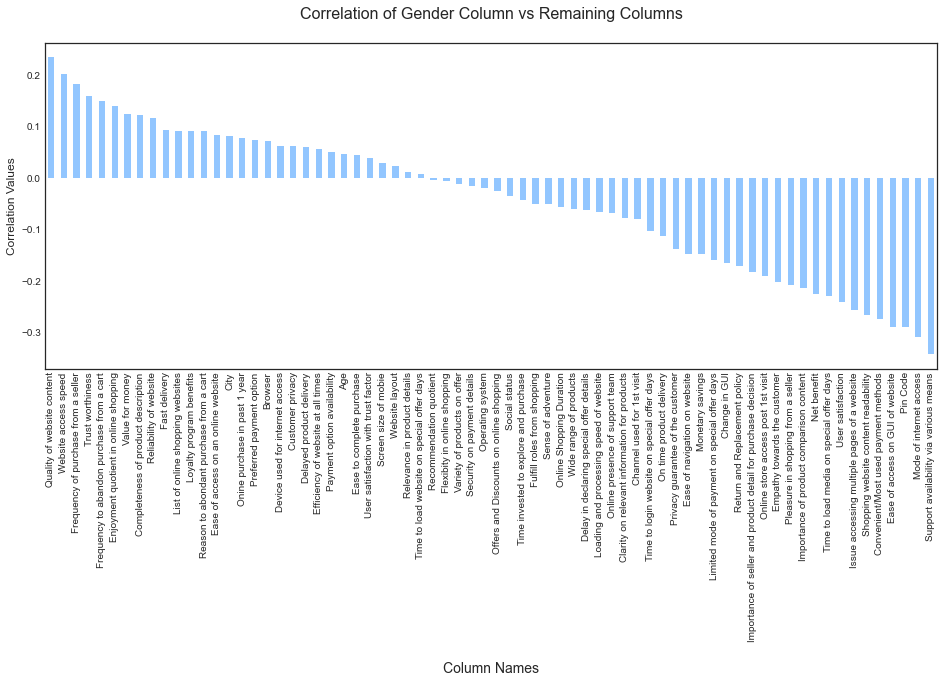

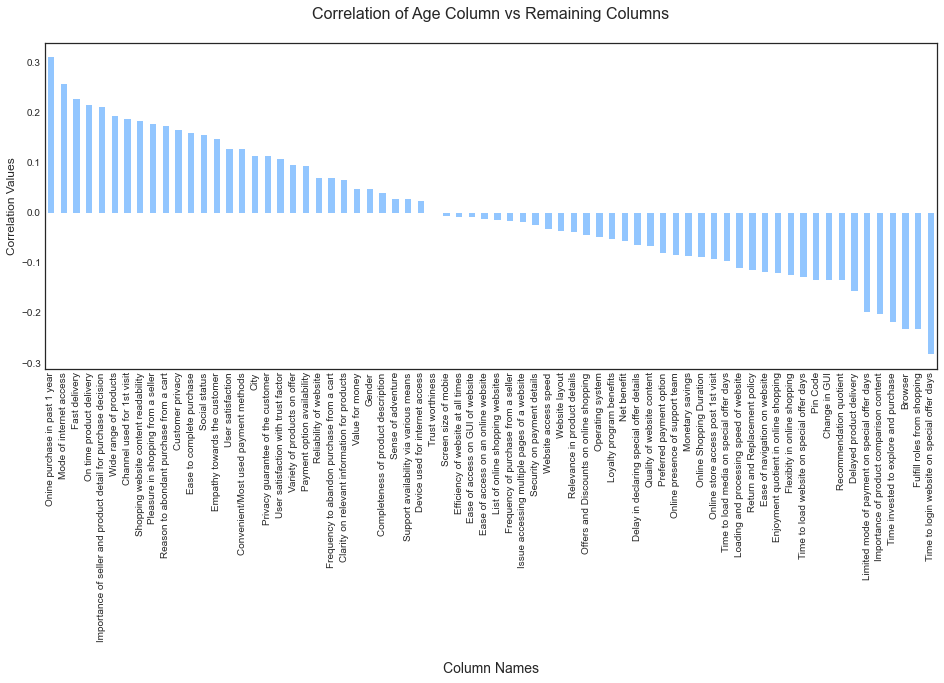

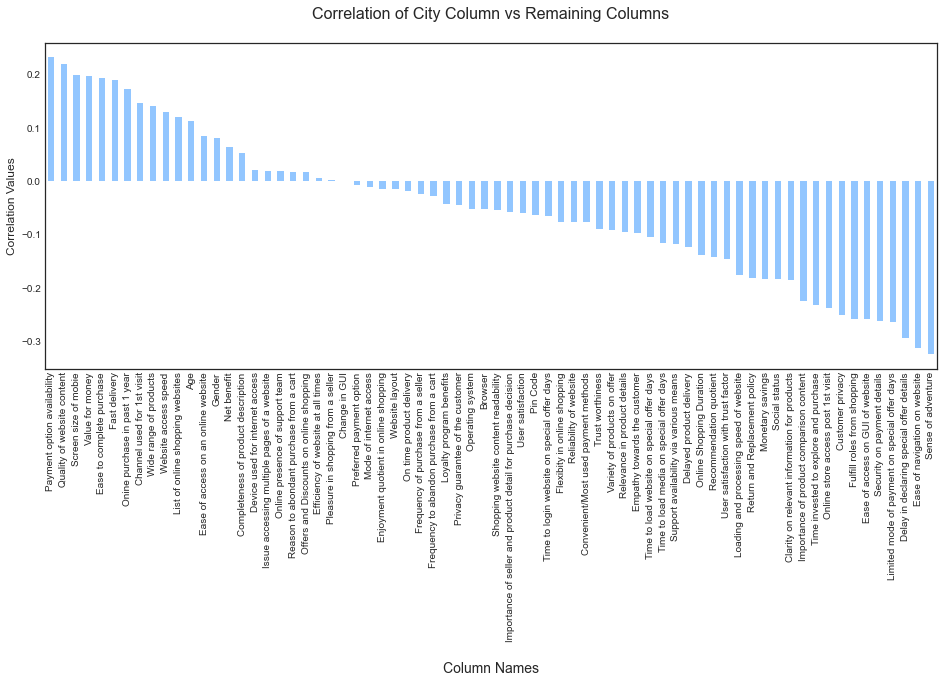

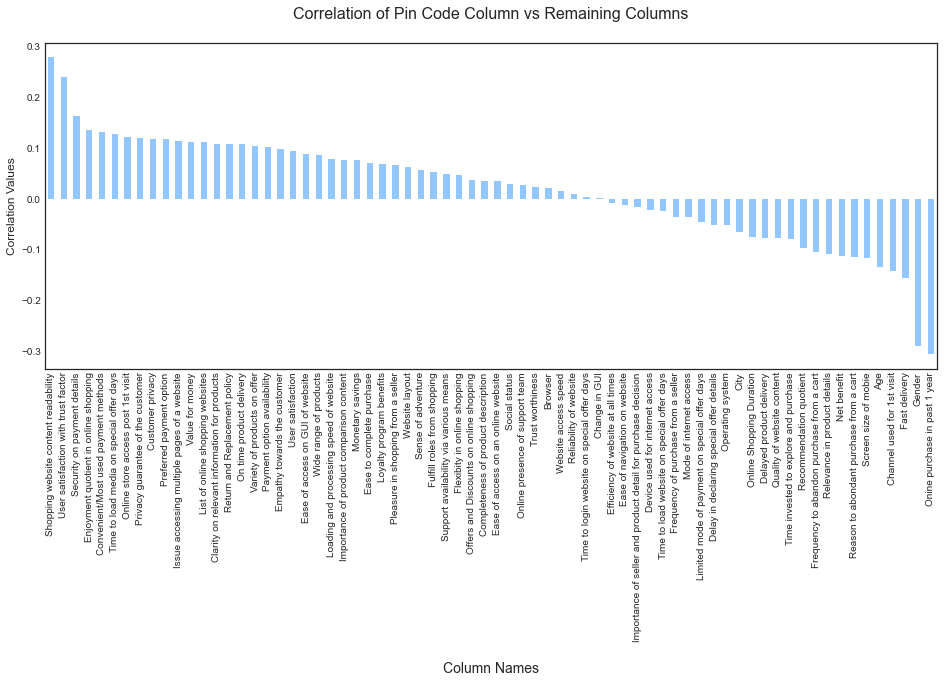

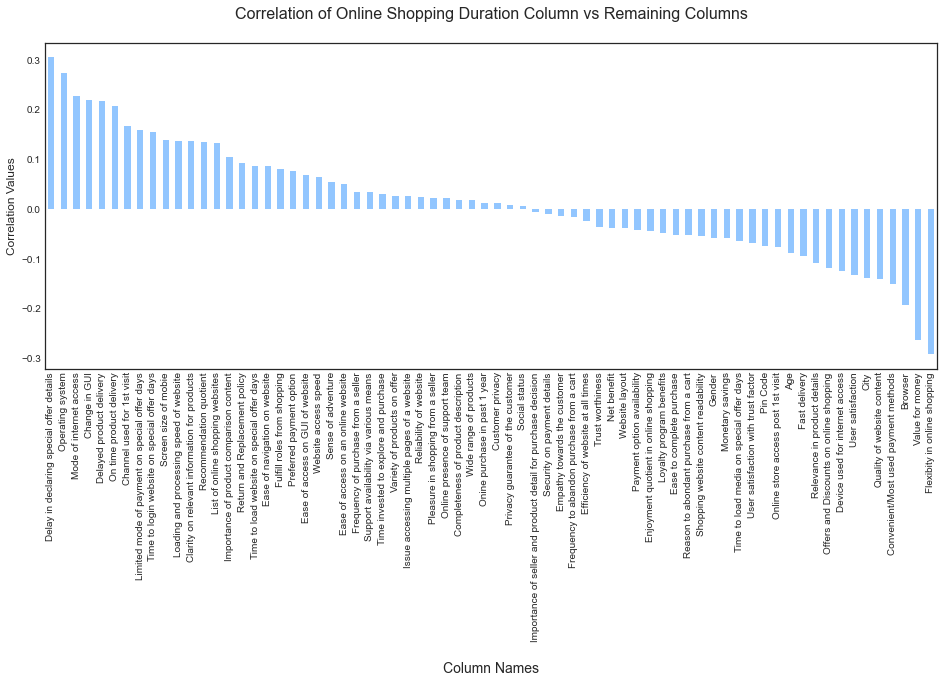

...

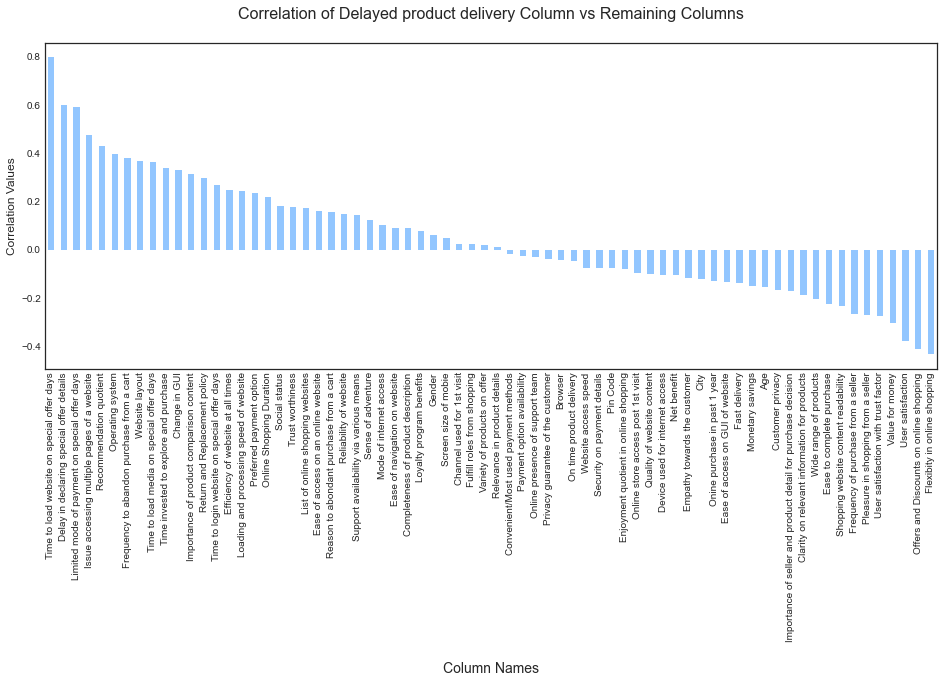

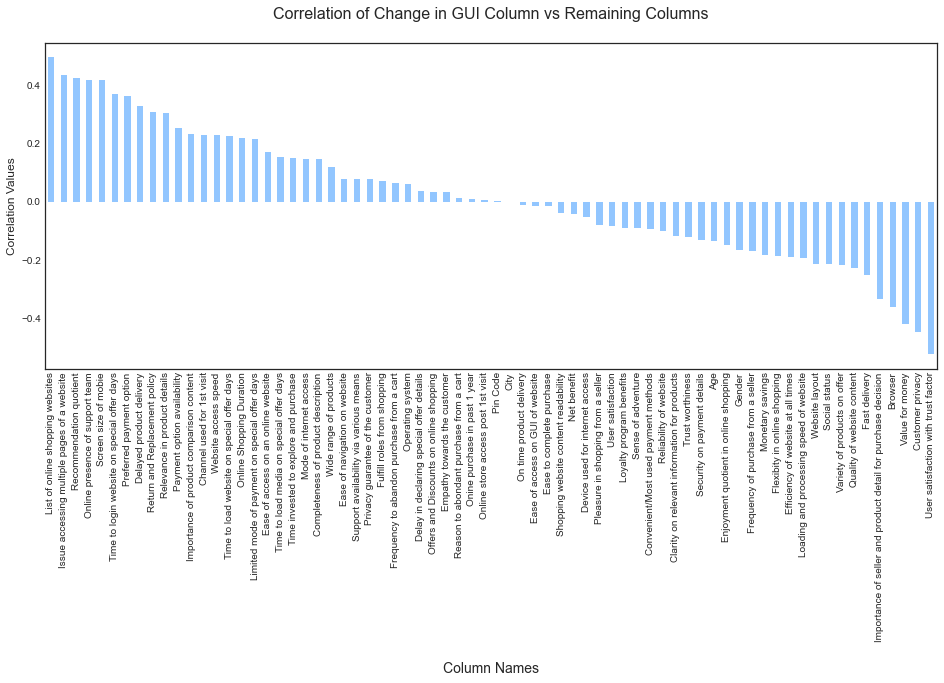

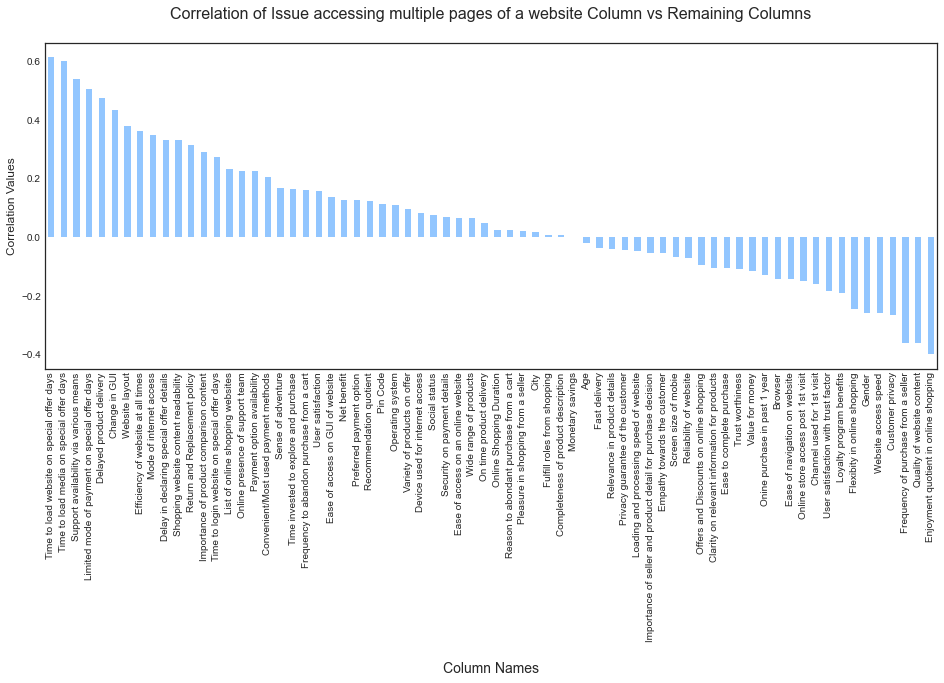

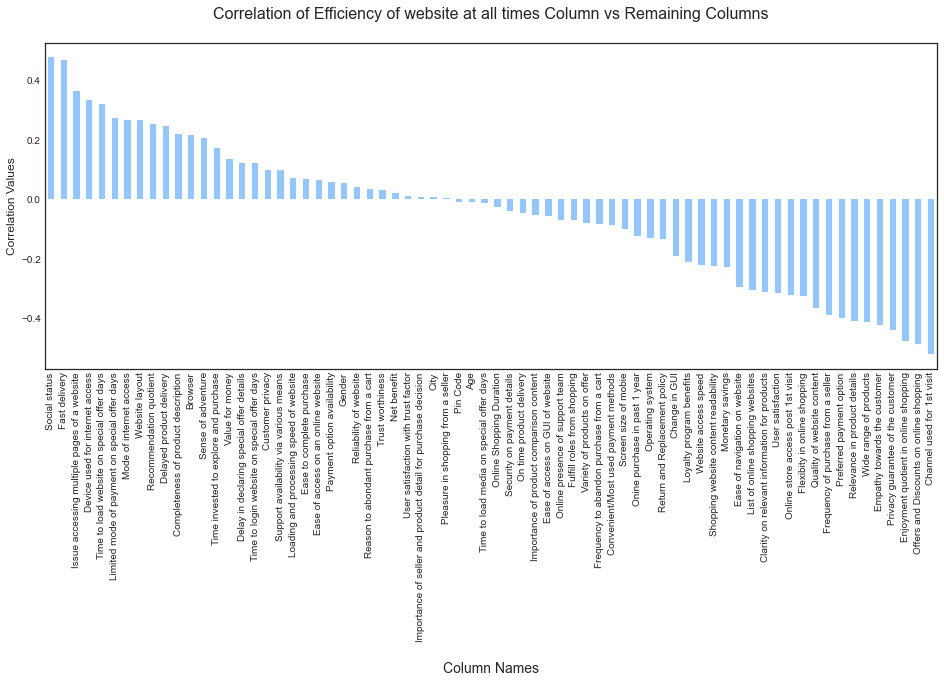

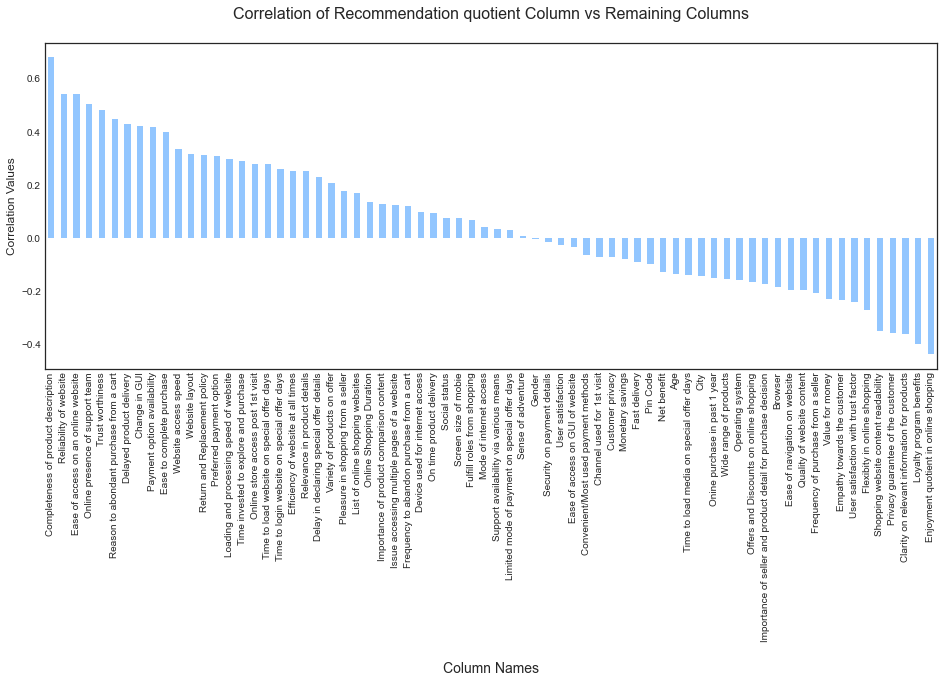

In [192]:
#Comparing the Gender column to the other columns

plt.style.use('seaborn-pastel')

column_names = df1.columns
for col in df1[column_names]:
    df_corr = df1.corr()
    plt.figure(figsize=(16,6))
    df_corr[col].sort_values(ascending=False).drop(col).plot.bar()
    plt.title("Correlation of {} Column vs Remaining Columns\n".format(col), fontsize=16)
    plt.xlabel("\nColumn Names", fontsize=14)
    plt.ylabel("Correlation Values", fontsize=12)
    plt.show()

So the heatmap's values were unclear, I created this barplot to display the positive and negative correlation data for each column versus the remaining column.

## Inference:

### 1. Amazon.com

#### To be improved: 
* During promotions, attempt to provide customers with a stress-free purchasing experience.
* Customers should have additional payment alternatives.
* During a promotion, try to provide a price as soon as possible.
* Reduce the time it takes for things to arrive.

#### Summary of positive feedback: 
* Easy to use and a decent purchasing website.
* Products are delivered quickly.
* Complete product information is readily available.
* Multi-channel availability of online aid.
* Trustworthy website or app, as well as perceived trustworthiness.



### 2. Flipkart.com

#### To be better:

* During promotions, attempt to provide clients with a stress-free shopping experience.

* Customers should have additional payment alternatives.

* During the promotion, try to offer the pricing as soon as possible.

* Reduce the time it takes for things to arrive.

* The sole distinction between Flipkart and Amazon is that their feedbacks are practically identical, with varied percentages being the only variance.


#### Summary of positive feedback:

* It's easy to use, and it's also an excellent purchasing site.

* Products are delivered quickly.

* Complete product information is readily available.

* Multi-channel availability of online aid.

* Trustworthy website or app, as well as perceived trustworthiness.

* A wide range of goods are available.



### 3. Myntra.com

#### To be better:

* During promotions, attempt to provide clients with a stress-free shopping experience.

* During promotions, try to offer the price as soon as possible.

* Reduce the time it takes for merchandise to arrive during promotions.

#### Summary of positive feedback: 

* Easy to use and an excellent website.

* Several payment alternatives are available.

* Faster delivery of merchandise.

* Complete product information is provided.

* Trustworthy website or app, as well as perceived trustworthiness.

* A wide range of goods are available.



### 4. Paytm.com

#### To be better:

* Reduce the time it takes for merchandise to arrive during promotions.

* During the promotion, try to offer the pricing as soon as possible.

* During promotions, attempt to provide clients with a stress-free shopping experience.

* Price and discount announcements are made late.

* When navigating from one page to the next, there is a lot of disruption.

#### Summary of positive feedback:
* It's easy to use and has an excellent webpage.

* The ability to finish a transaction in a timely manner.

* Approximately 64% of customers believe that either the web or the app is trustworthy.

* Paytm is thought to have a wide range of items, according to 20% of consumers.



### 5. Snapdeal.com

#### To be bettered:

* Reduce the time it takes for merchandise to arrive during promotions.
* During the promotion, try to offer the pricing as soon as possible.
* During promotions, attempt to provide clients with a stress-free shopping experience.
* Price and discount announcements are made late.
* No one has indicated a desire to promote Snapdeal to a contact since it has the most number of negative reviews of any other website.

#### Summary of positive feedback:
* It's simple to use.
* Customers are pleased with the availability of financial information security in 54 percent of cases.

## Conclusion:

1. The first 47 characteristics, based on general observations, give insights into how the e-tailer is helping and expanding depending on client suggestions. The data revealed which CITY, PIN CODE, AGE GROUP, and other variables were utilised most frequently on the web platform. It also revealed that some factors are given less weight in contributing to the success of an e-commerce store; as a result, we could eliminate those factors while keeping all of the important ones, as well as improve on some of the factors that influence online customers' repeat purchase intentions.


2. Aside from the first 47 elements, the remaining attributes demonstrated which online platform has been used more frequently based on success factors. According to the case study for client activation and retention, Amazon is the most dependable and has met the customer's needs. Data indicated that Flipkart was utilised more for online buying after Amazon.


3. According to a case study of Indian e-commerce clients, Amazon and Flipkart are the most frequently utilised for online shopping and are the most frequently suggested by friends. So, based on the research findings, Amazon and Flipkart are e-commerce platforms that combine utilitarian and hedonistic values to favourably influence repeat purchase intention (loyalty).